In [3]:
import matplotlib.pyplot as plt
import joblib
import sys
import plotly.express as px
import pandas as pd
from pandarallel import pandarallel
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from src.tools import JsonHandler, concatenate_listings_datasets, return_cleaned_col_names, preprocess_text
from src.class_transformers import (
    GeographicTransformer,
    BathroomsTransformer,
    CreateVerificationsTransformer,
    AmenitiesTransformer,
    OfflineLocationFinder,
    PropertyTypeTransformer,
    HostLocationImputer,
    ScrapingDateTransformer,
    ColumnDropperTransformer
)
from src.function_transformers import (
    fun_tr_id_to_string,
    fun_tr_from_string_to_rate,
    fun_tr_transform_to_datetime,
    fun_tr_remove_dollar_sign,
)
from sklearn.utils import estimator_html_repr
from sklearn import set_config
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

from textblob import TextBlob
pandarallel.initialize()
pd.options.display.float_format = "{:.0f}".format
handler = JsonHandler()
import pandas as pd
import numpy as np
import re
from feature_engine.datetime import DatetimeSubtraction
from feature_engine.creation import RelativeFeatures
from feature_engine.encoding import OneHotEncoder, CountFrequencyEncoder, OrdinalEncoder
from feature_engine.wrappers import SklearnTransformerWrapper
from feature_engine.imputation import MeanMedianImputer, CategoricalImputer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler, Normalizer, MaxAbsScaler, PolynomialFeatures, PowerTransformer, RobustScaler
from sklearn.impute import KNNImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import explained_variance_score, mean_absolute_error, mean_squared_error, r2_score, make_scorer, mean_absolute_percentage_error
from sklearn.pipeline import Pipeline
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import QuantileRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.model_selection import GridSearchCV
import sys
from sklearn.neural_network import MLPRegressor



INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.


In [4]:
df = pd.read_csv("data/city_data/step_by_step.csv")

## Feature separation

In [5]:
numerical_features = [
    'host_response_rate',
    'host_acceptance_rate',
    'price',
    'host_location',
    'host_listings_count',
    'host_total_listings_count',
    'latitude',
    'longitude',
    'accommodates',
    'bathrooms',
    'bedrooms',
    'beds',
    'minimum_nights',
    'maximum_nights',
    'number_of_reviews',
    'review_scores_rating',
    'review_scores_accuracy',
    'review_scores_cleanliness',
    'review_scores_checkin',
    'review_scores_communication',
    'review_scores_location',
    'review_scores_value',
    'reviews_per_month',
    'listing_city_pop',
]

In [6]:
binary_features = [
    'host_has_profile_pic',
    'host_identity_verified',
    "host_is_superhost",
    'email_verification',
    'phone_verification',
    'work_email_verification',
    'amenities_internet',
    'amenities_self-checkin',
    'amenities_host-greeting',
    'amenities_pool',
    'amenities_oven',
    'amenities_microwave',
    'amenities_garden',
    'amenities_streaming',
    'amenities_gym',
    'amenities_elevator',
    'amenities_heating',
    'amenities_air-conditioning',
    'amenities_workspace',
    'amenities_freezer',
    'amenities_first-aid-kit',
    'amenities_dishwasher',
    'amenities_long-term-stays',
    'amenities_pets-allowed',
    'amenities_bathtube',
    'amenities_bbq-grill',
    'amenities_lake-bay-view'
]

## Description elaboration

In [7]:
def preprocess_text(text):
    text = str(text).lower()
    # Remove punctuation and special characters
    text = re.sub(r'[^a-z\s]', '', text)
    # Remove stop words
    text = ' '.join([word for word in text.split() if word not in ENGLISH_STOP_WORDS])
    return text

df['description'] = df['description'].parallel_apply(preprocess_text)

In [8]:
df['description_word_count'] = df['description'].parallel_apply(lambda x: len(x.split()))

In [9]:
df['description_sentiment_polarity'] = df['description'].parallel_apply(lambda x: TextBlob(x).sentiment.polarity)
df['description_sentiment_subjectivity'] = df['description'].parallel_apply(lambda x: TextBlob(x).sentiment.subjectivity)

In [10]:
fig = px.histogram(df[["description_sentiment_subjectivity", "description_sentiment_polarity"]], x="description_sentiment_subjectivity")
fig.show()

In [11]:
fig = px.histogram(df[["description_sentiment_subjectivity", "description_sentiment_polarity"]], x="description_sentiment_polarity")
fig.show()

In [12]:
description_feature = [
    "description_word_count",
    "description_sentiment_polarity",
    "description_sentiment_subjectivity"
]

other_features = list(
    set(df.columns.tolist()) - set(numerical_features) - set(binary_features) - set(description_feature))


## Correlation between features

In [13]:
df_corr = df.copy()
corr_full = df_corr[numerical_features].corr()
colors = ['green' if val < 0.7 else 'red' for val in corr_full.values.flatten()]
mask = np.where(corr_full < 0.7, 0, 1)

fig = px.imshow(corr_full,
                text_auto=True,
                aspect="auto",
                width=900,
                height=900
                )

fig.show()

In [14]:
fig = px.imshow(corr_full,
                text_auto=True,
                aspect="auto",
                width=900,
                height=900,
                color_continuous_scale=["green", "red"])

fig.update_traces(z=mask, colorscale=[[0, "green"], [1, "red"]])

fig.show()

### Create some features

In [15]:
df["beds_for_bedroom"] = np.where(df["bedrooms"] != 0, df["beds"] / df["bedrooms"], 0)

### Drop highly correlates

In [16]:
numerical_features = [
    "beds_for_bedroom",
    'host_response_rate',
    'host_acceptance_rate',
    'price',
    'host_location',
    'host_listings_count',
    'latitude',
    'longitude',
    'accommodates',
    'bathrooms',
    'minimum_nights',
    'maximum_nights',
    'number_of_reviews',
    'review_scores_rating',
    'review_scores_checkin',
    'review_scores_location',
    'review_scores_value',
    'reviews_per_month',
    'listing_city_pop',
]

In [17]:
df_corr = df.copy()
corr_full = df_corr[numerical_features].corr()

fig = px.imshow(corr_full,
                text_auto=True,
                aspect="auto",
                width=900,
                height=900
                )

fig.show()

In [18]:
other_features = list(set(df.columns.tolist()) - set(numerical_features) - set(binary_features) - set(description_feature))

### Exploration

*Data exploration of features. Firstly the binary ones with respect to price*.

*Then engineer the other features as needed and observe their relationship with price*.

In [19]:
#for var in binary_features:
#    fig = px.histogram(df,
#                       x = f"{var}",
#                       color="df_city_location",
#                       barmode='group'
#                       )
#    fig.show()

## Managing Other Features

In [20]:
ohe_features = [
    "property_type",
    "df_city_location",
    "room_type",
    "host_response_time",
    "bathrooms_text"
]

In [21]:
df["scraping_date"] = max(df["last_review"])

In [22]:
date_features = [
    "host_since",
    "last_review",
    "first_review",
    "scraping_date"
]

In [23]:
host_id_feature = [
    "host_id"
]

In [24]:
other_features = list(set(other_features) - set(ohe_features) - set(date_features) - set(host_id_feature))

## Prediction

In [25]:
testing = df.drop(other_features, axis=1)

In [26]:
testing.replace({"f": 0, "t": 1}, inplace=True)

/tmp/ipykernel_18094/2451200246.py:1: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [27]:
testing.reset_index(inplace=True)
testing.drop(["id"], inplace=True, axis=1)

In [28]:
testing.dropna(inplace=True)

In [30]:
testing = testing.loc[testing["price"] < 1000, :]

In [31]:
train_set, test_set = train_test_split(testing, test_size=0.2, random_state=42)

In [32]:
fig = px.histogram(train_set,
                   x = "price")
fig.show()


In [33]:
X_train = train_set.drop(["price"], axis=1)
X_test = test_set.drop(["price"], axis=1)

y_train = train_set["price"]
y_test = test_set["price"]

In [34]:
wizard_pipe = Pipeline(
    steps=[
        (
            "OHE_imputation",
            CategoricalImputer(
                imputation_method="frequent",
                variables=ohe_features,
                return_object=True,
                ignore_format=False,
            ),
        ),
        (
            "OHE_encoding",
            OneHotEncoder(
                top_categories=None,
                drop_last=True,
                drop_last_binary=True,
                ignore_format=False,
                variables=ohe_features,
            ),
        ),
        # Review Dates (RD)
        (
            "RD_engineering",
            DatetimeSubtraction(
                variables="last_review",
                reference="first_review",
                output_unit="D",
                drop_original=False,
                new_variables_names=["days_active_reviews"],
                missing_values="ignore",
            ),
        ),
        (
            "RD_imputation",
            MeanMedianImputer(
                imputation_method="median", variables=["days_active_reviews"]
            ),
        ),
        # Host since (HS)
        (
            "HS_engineering",
            DatetimeSubtraction(
                variables=["scraping_date"],
                reference=["host_since"],
                output_unit="D",
                drop_original=False,
                new_variables_names=["host_since_days"],
                missing_values="ignore",
            ),
        ),
        (
            "HS_imputation",
            MeanMedianImputer(
                imputation_method="median", variables=["host_since_days"]
            ),
        ),
        # Host ID (HID)
        (
            "HID_imputation",
            CategoricalImputer(
                imputation_method="missing",
                variables=host_id_feature,
                fill_value="MISSING",
            ),
        ),
        (
            "HID_encoding",
            CountFrequencyEncoder(
                encoding_method="count", missing_values="ignore", unseen="encode"
            ),
        ),
        (
            "Drop columns",
            ColumnDropperTransformer(
                columns=[
                    "last_review",
                    "first_review",
                    "scraping_date",
                    "host_since"
                ]
            )
        ),
        (
            "Standardize",
            StandardScaler(),
        ),
        (
            "Model",
            MLPRegressor(),
        )
    ],
    verbose=True
)


In [35]:
param_grid = {
    'Model__hidden_layer_sizes': [(100, 100, 100,)],
    'Model__activation': ['logistic'],
    'Model__solver': ['adam', "sgd"],
    'Model__alpha': [0.0001, 0.001, 0.01, 0.1],
    'Model__learning_rate': ['constant', 'invscaling', 'adaptive'],
    'Model__learning_rate_init': [0.001, 0.01, 0.1],
    'Model__random_state':[874631],
    'Model__tol':[1e-4],
    'Model__verbose':[True],
    'Model__momentum': [0.8, 0.9],
    'Model__n_iter_no_change': [200],
    'Model__max_iter': [500],
    'Model__early_stopping': [True],
    #'Model__validation_fraction': [0.1, 0.2, 0.3],
    #'transformer__method': ['yeo-johnson'],
    #'transformer__standardize': [True],
    #'transformer__copy': [False]
}

scoring = {
    'mean_absolute_error': make_scorer(mean_absolute_error, greater_is_better=False),
    'mean_squared_error': make_scorer(mean_squared_error, greater_is_better=False),
    'r2_score': make_scorer(r2_score, greater_is_better=True),
}

In [36]:
grid_pipeline = GridSearchCV(
    wizard_pipe,
    param_grid=param_grid,
    refit="mean_absolute_error",
    scoring=scoring,
    n_jobs=-1,
    pre_dispatch=4, # avoid jobs explosion
    cv=5,        # use default 5 fold cross val,
    verbose=4,
    return_train_score=False
    )

grid_pipeline.fit(X_train, y_train)

Fitting 5 folds for each of 144 candidates, totalling 720 fits
INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.6s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   2.1s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.5s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.1s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.3s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.1s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.1s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.3s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.3s
Iteration 1, loss = 17962.84853011
Validation score: -1.388646
Iteration 2, loss = 15

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 148, loss = 7190.91100611
Validation score: -0.633575
Iteration 149, loss = 7123.18052425
Validation score: -0.147607
Iteration 150, loss = 7139.49875972
Validation score: -3.306480
Iteration 151, loss = 7250.24790203
Validation score: -1.855300
Iteration 152, loss = 7195.16837654
Validation score: -0.438339
Iteration 153, loss = 7098.11378228
Validation score: -1.136906
Iteration 154, loss = 7154.22474535
Validation score: -0.082225
Iteration 155, loss = 7128.83702287
Validation score: -0.000026
Iteration 156, loss = 7134.49129710
Validation score: -0.783302
Iteration 157, loss = 7110.53141012
Validation score: -0.357871
Iteration 158, loss = 7121.82741116
Validation score: -1.804886
Iteration 159, loss = 7169.44461883
Validation score: -0.747975
Iteration 160, loss = 7145.33106638
Validation score: -1.209379
Iteration 161, loss = 7194.68516105
Validation score: -1.330507
Iteration 162, loss = 7174.18227605
Validation score: -1.511844
Iteration 163, loss = 7191.53836227
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.382019
Iteration 134, loss = 4239.65086111
Validation score: 0.370267
Iteration 135, loss = 4229.37987918
Validation score: 0.404659
Iteration 136, loss = 4311.75972330
Validation score: 0.394190
Iteration 137, loss = 4288.93746908
Validation score: 0.371738
Iteration 138, loss = 4415.60095623
Validation score: 0.384218
Iteration 139, loss = 4274.85271418
Validation score: 0.398105
Iteration 140, loss = 4289.88462162
Validation score: 0.387622
Iteration 141, loss = 4381.45951497
Validation score: 0.385105
Iteration 142, loss = 4293.38141352
Validation score: 0.388105
Iteration 143, loss = 4383.00284681
Validation score: 0.356986
Iteration 144, loss = 4324.72296051
Validation score: 0.401822
Iteration 145, loss = 4264.78102212
Validation score: 0.390599
Iteration 146, loss = 4231.75565623
Validation score: 0.401739
Iteration 147, loss = 4249.90094399
Validation score: 0.390177
Iteration 148, loss = 4244.82711236
Validation score: 0.381092
Iteration 149, loss = 4298.9

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.7s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.2s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.1s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.2s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 7601.93926034
Validation score: -0.001350
Iteration 2, loss = 6941.66100318
Validation score: -0.000752
Iteration 3, loss = 6943

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Iteration 290, loss = 4182.37919444
Validation score: 0.388934
Iteration 291, loss = 4214.04789060
Validation score: 0.389691
Iteration 292, loss = 4145.53410664
Validation score: 0.389986
Iteration 293, loss = 4126.24329925
Validation score: 0.398882
Iteration 294, loss = 4145.27228472
Validation score: 0.394411
Iteration 295, loss = 4169.37438813
Validation score: 0.392247
Iteration 296, loss = 4170.95060487
Validation score: 0.396595
Iteration 297, loss = 4129.76154901
Validation score: 0.382755
Iteration 298, loss = 4207.66743446
Validation score: 0.386322
Iteration 299, loss = 4190.05902016
Validation score: 0.376000
Iteration 300, loss = 4170.98101248
Validation score: 0.381121
Iteration 301, loss = 4295.86021865
Validation score: 0.378385
Iteration 302, loss = 4232.13721365
Validation score: 0.376997
Iteration 303, loss = 4197.61200835
Validation score: 0.396013
Iteration 304, loss = 4148.46506389
Validation score: 0.387002
Iteration 305, loss = 4139.66126743
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.055236
Iteration 188, loss = 6497.66892872
Validation score: 0.055252
Iteration 189, loss = 6497.34101817
Validation score: 0.055267
Iteration 190, loss = 6497.13448077
Validation score: 0.055285
Iteration 191, loss = 6496.88705102
Validation score: 0.055299
Iteration 192, loss = 6496.65142171
Validation score: 0.055328
Iteration 193, loss = 6496.29372778
Validation score: 0.055373
Iteration 194, loss = 6496.01702665
Validation score: 0.055390
Iteration 195, loss = 6495.73982434
Validation score: 0.055418
Iteration 196, loss = 6495.45462160
Validation score: 0.055435
Iteration 197, loss = 6495.18111149
Validation score: 0.055463
Iteration 198, loss = 6494.86640614
Validation score: 0.055493
Iteration 199, loss = 6494.58309799
Validation score: 0.055536
Iteration 200, loss = 6494.33719848
Validation score: 0.055567
Iteration 201, loss = 6494.05621342
Validation score: 0.055596
Iteration 202, loss = 6493.77959017
Validation score: 0.055627
Iteration 203, loss = 6493.5

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 461, loss = 4077.81711321
Validation score: 0.392782
Iteration 462, loss = 4077.19214040
Validation score: 0.392906
Iteration 463, loss = 4076.58671653
Validation score: 0.392874
Iteration 464, loss = 4075.93076119
Validation score: 0.392960
Iteration 465, loss = 4075.45739785
Validation score: 0.393206
Iteration 466, loss = 4074.68214466
Validation score: 0.393358
Iteration 467, loss = 4074.07703134
Validation score: 0.393354
Iteration 468, loss = 4073.41471741
Validation score: 0.393275
Iteration 469, loss = 4072.73552812
Validation score: 0.393448
Iteration 470, loss = 4072.17527290
Validation score: 0.393526
Iteration 471, loss = 4071.46223577
Validation score: 0.393598
Iteration 472, loss = 4070.91505328
Validation score: 0.393627
Iteration 473, loss = 4070.11680063
Validation score: 0.393522
Iteration 474, loss = 4069.67004377
Validation score: 0.393727
Iteration 475, loss = 4068.96391722
Validation score: 0.393872
Iteration 476, loss = 4068.21991275
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.322373
Iteration 374, loss = 4647.30081155
Validation score: 0.322495
Iteration 375, loss = 4646.51284030
Validation score: 0.322490
Iteration 376, loss = 4645.86078449
Validation score: 0.322650
Iteration 377, loss = 4645.10029542
Validation score: 0.322742
Iteration 378, loss = 4644.35948337
Validation score: 0.322777
Iteration 379, loss = 4643.58451395
Validation score: 0.322834
Iteration 380, loss = 4642.82661294
Validation score: 0.322888
Iteration 381, loss = 4642.12297526
Validation score: 0.323027
Iteration 382, loss = 4641.35045299
Validation score: 0.323141
Iteration 383, loss = 4640.61465825
Validation score: 0.323233
Iteration 384, loss = 4639.82981681
Validation score: 0.323349
Iteration 385, loss = 4639.10556307
Validation score: 0.323380
Iteration 386, loss = 4643.28787824
Validation score: 0.323517
Iteration 387, loss = 4638.45574507
Validation score: 0.323484
Iteration 388, loss = 4637.14988477
Validation score: 0.323524
Iteration 389, loss = 4636.3

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 12147.90454772
Validation score: -0.164023
Iteration 2, loss = 7250.50991825
Validation score: -0.004146
Iteration 3, loss = 646

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV 3/5] END Model__activation=logistic, Model__alpha=0.0001, Model__early_stopping=True, Model__hidden_layer_sizes=(100, 100, 100), Model__learning_rate=invscaling, Model__learning_rate_init=0.01, Model__max_iter=500, Model__momentum=0.8, Model__n_iter_no_change=200, Model__random_state=874631, Model__solver=sgd, Model__tol=0.0001, Model__verbose=True; mean_absolute_error: (test=-57.654) mean_squared_error: (test=-8914.665) r2_score: (test=0.348) total time= 7.0min
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.5s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) 

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.211921
Iteration 374, loss = 5391.06602438
Validation score: 0.212510
Iteration 375, loss = 5387.93932460
Validation score: 0.212961
Iteration 376, loss = 5394.48367023
Validation score: 0.213494
Iteration 377, loss = 5382.56762235
Validation score: 0.213832
Iteration 378, loss = 5378.75120172
Validation score: 0.214094
Iteration 379, loss = 5375.20412646
Validation score: 0.214379
Iteration 380, loss = 5372.00057451
Validation score: 0.214232
Iteration 381, loss = 5380.75900613
Validation score: 0.214738
Iteration 382, loss = 5368.27167397
Validation score: 0.215453
Iteration 383, loss = 5363.60223039
Validation score: 0.215801
Iteration 384, loss = 5359.08288961
Validation score: 0.216158
Iteration 385, loss = 5355.66595330
Validation score: 0.216732
Iteration 386, loss = 5352.24034561
Validation score: 0.217100
Iteration 387, loss = 5348.73646665
Validation score: 0.217455
Iteration 388, loss = 5345.55417600
Validation score: 0.217949
Iteration 389, loss = 5342.0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 274, loss = 5590.77974401
Validation score: 0.182579
Iteration 275, loss = 5590.29019288
Validation score: 0.182651
Iteration 276, loss = 5589.90246677
Validation score: 0.182648
Iteration 277, loss = 5589.39825383
Validation score: 0.182646
Iteration 278, loss = 5589.58281958
Validation score: 0.182579
Iteration 279, loss = 5588.65637251
Validation score: 0.182583
Iteration 280, loss = 5588.12091514
Validation score: 0.182638
Iteration 281, loss = 5587.72713089
Validation score: 0.182680
Iteration 282, loss = 5587.35078543
Validation score: 0.182707
Iteration 283, loss = 5586.97735795
Validation score: 0.182747
Iteration 284, loss = 5586.62307376
Validation score: 0.182774
Iteration 285, loss = 5586.31424554
Validation score: 0.182801
Iteration 286, loss = 5585.98190076
Validation score: 0.182788
Iteration 287, loss = 5585.63936200
Validation score: 0.182824
Iteration 288, loss = 5585.32591463
Validation score: 0.182814
Iteration 289, loss = 5585.03172549
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 6857.56963693
Validation score: -1.069461
Iteration 2, loss = 19879.83957181
Validation score: 0.169540
Iteration 3, loss = 5774.10067306
Validation score: 0.171663
Iteration 4, loss = 5766.50252893
Validation score: 0.175295
Iteration 5, loss = 5714.10250293
Validation

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV 1/5] END Model__activation=logistic, Model__alpha=0.0001, Model__early_stopping=True, Model__hidden_layer_sizes=(100, 100, 100), Model__learning_rate=invscaling, Model__learning_rate_init=0.01, Model__max_iter=500, Model__momentum=0.9, Model__n_iter_no_change=200, Model__random_state=874631, Model__solver=sgd, Model__tol=0.0001, Model__verbose=True; mean_absolute_error: (test=-62.455) mean_squared_error: (test=-10335.306) r2_score: (test=0.247) total time= 7.0min
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.5s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.2s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11)

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 404, loss = 5471.97300184
Validation score: 0.197881
Iteration 405, loss = 5470.42488016
Validation score: 0.198121
Iteration 406, loss = 5468.85986774
Validation score: 0.198306
Iteration 407, loss = 5467.40853678
Validation score: 0.198469
Iteration 408, loss = 5466.05230973
Validation score: 0.198668
Iteration 409, loss = 5464.70392825
Validation score: 0.198846
Iteration 410, loss = 5463.34941497
Validation score: 0.199008
Iteration 411, loss = 5462.14795353
Validation score: 0.199097
Iteration 412, loss = 5460.89547278
Validation score: 0.199335
Iteration 413, loss = 5459.53153718
Validation score: 0.199591
Iteration 414, loss = 5458.27853262
Validation score: 0.199708
Iteration 415, loss = 5456.94656232
Validation score: 0.199905
Iteration 416, loss = 5455.67003051
Validation score: 0.200057
Iteration 417, loss = 5454.35409887
Validation score: 0.200307
Iteration 418, loss = 5453.59926982
Validation score: 0.200657
Iteration 419, loss = 5451.65121557
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 117, loss = 6945.76661794
Validation score: -0.001435
Iteration 118, loss = 6944.11436844
Validation score: -0.007984
Iteration 119, loss = 6945.19367505
Validation score: -0.019098
Iteration 120, loss = 6952.36235283
Validation score: -0.023131
Iteration 121, loss = 6947.38104140
Validation score: -0.000704
Iteration 122, loss = 6942.31421024
Validation score: -0.003641
Iteration 123, loss = 6946.48985462
Validation score: -0.040761
Iteration 124, loss = 6955.91440138
Validation score: -0.009001
Iteration 125, loss = 6946.50199746
Validation score: -0.002323
Iteration 126, loss = 6946.36041946
Validation score: -0.002920
Iteration 127, loss = 6946.89957571
Validation score: -0.000683
Iteration 128, loss = 6948.84671712
Validation score: -0.005328
Iteration 129, loss = 6944.46095412
Validation score: -0.001369
Iteration 130, loss = 6944.88694126
Validation score: -0.012024
Iteration 131, loss = 6950.32885714
Validation score: -0.014710
Iteration 132, loss = 6946.91151408
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.329263
Iteration 337, loss = 1531.93250260
Validation score: 0.305385
Iteration 338, loss = 1511.53419470
Validation score: 0.319895
Iteration 339, loss = 1475.57226326
Validation score: 0.319693
Iteration 340, loss = 1453.80008350
Validation score: 0.316298
Iteration 341, loss = 1439.59681620
Validation score: 0.316747
Iteration 342, loss = 1429.48338582
Validation score: 0.300096
Iteration 343, loss = 1447.25506271
Validation score: 0.148671
Iteration 344, loss = 1749.33270994
Validation score: 0.335788
Iteration 345, loss = 1598.63328475
Validation score: 0.331695
Iteration 346, loss = 1561.95349998
Validation score: 0.322774
Iteration 347, loss = 1525.18397816
Validation score: 0.325365
Iteration 348, loss = 1490.62522213
Validation score: 0.319305
Iteration 349, loss = 1465.20135075
Validation score: 0.324461
Iteration 350, loss = 1450.67510524
Validation score: 0.313828
Iteration 351, loss = 1439.55343348
Validation score: 0.317999
Iteration 352, loss = 1423.4

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.422592
Iteration 492, loss = 2642.13054445
Validation score: 0.433031
Iteration 493, loss = 2543.35658133
Validation score: 0.435041
Iteration 494, loss = 2535.58070352
Validation score: 0.434333
Iteration 495, loss = 2529.88708832
Validation score: 0.396788
Iteration 496, loss = 2533.08745006
Validation score: 0.257476
Iteration 497, loss = 2704.08726748
Validation score: 0.418080
Iteration 498, loss = 2531.34902535
Validation score: 0.435310
Iteration 499, loss = 2526.79613676
Validation score: 0.436116
Iteration 500, loss = 2526.93848615
Validation score: 0.435501
[Pipeline] ........... (step 11 of 11) Processing Model, total= 6.9min
[CV 1/5] END Model__activation=logistic, Model__alpha=0.0001, Model__early_stopping=True, Model__hidden_layer_sizes=(100, 100, 100), Model__learning_rate=adaptive, Model__learning_rate_init=0.001, Model__max_iter=500, Model__momentum=0.8, Model__n_iter_no_change=200, Model__random_state=874631, Model__solver=sgd, Model__tol=0.0001, M

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 237, loss = 6912.39832844
Validation score: -0.001681
Iteration 238, loss = 6911.04916492
Validation score: -0.002663
Iteration 239, loss = 6911.00118894
Validation score: -0.000679
Iteration 240, loss = 6912.19126299
Validation score: -0.001275
Iteration 241, loss = 6911.02428038
Validation score: -0.000715
Iteration 242, loss = 6910.78774919
Validation score: -0.003644
Iteration 243, loss = 6911.65553134
Validation score: -0.000240
Iteration 244, loss = 6911.06360972
Validation score: -0.001002
Iteration 245, loss = 6911.47175114
Validation score: -0.000697
Iteration 246, loss = 6912.15175434
Validation score: -0.000095
Iteration 247, loss = 6911.33080532
Validation score: -0.001506
Iteration 248, loss = 6911.06359118
Validation score: -0.001499
Iteration 249, loss = 6914.97072527
Validation score: -0.000148
Iteration 250, loss = 6911.02363894
Validation score: -0.000340
Iteration 251, loss = 6911.41960793
Validation score: -0.007476
Iteration 252, loss = 6914.87960426
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.275888
Iteration 465, loss = 1252.93133779
Validation score: 0.303770
Iteration 466, loss = 1277.88949244
Validation score: 0.289376
Iteration 467, loss = 1258.94584491
Validation score: 0.285597
Iteration 468, loss = 1255.55010526
Validation score: 0.282802
Iteration 469, loss = 1253.23882433
Validation score: 0.278009
Iteration 470, loss = 1252.11935744
Validation score: 0.279504
Iteration 471, loss = 1249.37908814
Validation score: 0.279810
Iteration 472, loss = 1248.62090165
Validation score: 0.277892
Iteration 473, loss = 1247.95174828
Validation score: 0.278403
Iteration 474, loss = 1246.94451292
Validation score: 0.277403
Iteration 475, loss = 1246.56135630
Validation score: 0.275473
Iteration 476, loss = 1246.46757503
Validation score: 0.275487
Iteration 477, loss = 1245.36877392
Validation score: 0.274154
Iteration 478, loss = 1244.73784330
Validation score: 0.276284
Iteration 479, loss = 1244.13100784
Validation score: 0.276186
Iteration 480, loss = 1243.7

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 313, loss = 6944.24486810
Validation score: -0.000369
Iteration 314, loss = 6932.54323810
Validation score: -0.002994
Iteration 315, loss = 6928.54441407
Validation score: -0.002250
Iteration 316, loss = 6933.52647476
Validation score: -0.000520
Iteration 317, loss = 6938.09018298
Validation score: -0.000607
Iteration 318, loss = 6931.18298879
Validation score: -0.003319
Iteration 319, loss = 6934.56848570
Validation score: -0.001659
Iteration 320, loss = 6934.41146836
Validation score: -0.000307
Iteration 321, loss = 6931.94384826
Validation score: -0.000320
Iteration 322, loss = 6934.05217936
Validation score: -0.000709
Iteration 323, loss = 6927.06597372
Validation score: -0.000642
Iteration 324, loss = 6929.71753199
Validation score: -0.000241
Iteration 325, loss = 6928.77098645
Validation score: -0.002681
Iteration 326, loss = 6930.66570806
Validation score: -0.000516
Iteration 327, loss = 6929.52350941
Validation score: -0.000002
Iteration 328, loss = 6929.29143154
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 243, loss = 6940.86056140
Validation score: -0.000077
Iteration 244, loss = 6938.34592568
Validation score: -0.001140
Iteration 245, loss = 6940.89277202
Validation score: -0.000182
Iteration 246, loss = 6942.87061019
Validation score: -0.000028
Iteration 247, loss = 6940.25444504
Validation score: -0.001202
Iteration 248, loss = 6940.07749353
Validation score: -0.004349
Iteration 249, loss = 6946.54766836
Validation score: -0.002693
Iteration 250, loss = 6941.33789611
Validation score: -0.001090
Iteration 251, loss = 6941.30097003
Validation score: -0.006831
Iteration 252, loss = 6945.07485449
Validation score: -0.021163
Iteration 253, loss = 6994.76382107
Validation score: -0.000632
Iteration 254, loss = 6940.77583697
Validation score: -0.002520
Iteration 255, loss = 6943.17254538
Validation score: -0.002007
Iteration 256, loss = 6946.05341840
Validation score: -0.000255
Iteration 257, loss = 6941.98154579
Validation score: -0.000356
Iteration 258, loss = 6941.91295008
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 487, loss = 6994.66796872
Validation score: -0.000061
Iteration 488, loss = 6994.99370011
Validation score: -0.000218
Iteration 489, loss = 6995.40996062
Validation score: -0.000247
Iteration 490, loss = 6995.23394549
Validation score: -0.000012
Iteration 491, loss = 7000.81719896
Validation score: -0.000391
Iteration 492, loss = 7000.47218986
Validation score: -0.000079
Iteration 493, loss = 6995.27667200
Validation score: -0.000062
Iteration 494, loss = 6994.98301271
Validation score: -0.000189
Iteration 495, loss = 6995.23863666
Validation score: -0.000236
Iteration 496, loss = 6995.53613085
Validation score: -0.000009
Iteration 497, loss = 6996.69302966
Validation score: -0.000095
Iteration 498, loss = 6995.50936392
Validation score: -0.000061
Iteration 499, loss = 6996.30940880
Validation score: -0.000031
Iteration 500, loss = 6995.23384995
Validation score: -0.000067
[Pipeline] ........... (step 11 of 11) Processing Model, total= 6.8min
[CV 1/5] END Model__activation=lo

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 12147.90454772
Validation score: -0.164023
Iteration 2, loss = 7250.50991825
Validation score: -0.004146
Iteration 3, loss = 646

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 471, loss = 7010.55124637
Validation score: -0.000000
Iteration 472, loss = 7011.44764588
Validation score: -0.000022
Iteration 473, loss = 7010.34564870
Validation score: -0.000390
Iteration 474, loss = 7010.70035375
Validation score: -0.000001
Iteration 475, loss = 7010.86853787
Validation score: -0.000068
Iteration 476, loss = 7010.44352383
Validation score: -0.000032
Iteration 477, loss = 7010.40228177
Validation score: -0.000105
Iteration 478, loss = 7011.00650213
Validation score: -0.000038
Iteration 479, loss = 7011.10808213
Validation score: -0.000052
Iteration 480, loss = 7010.77263119
Validation score: -0.000000
Iteration 481, loss = 7011.00175715
Validation score: -0.000295
Iteration 482, loss = 7010.99588324
Validation score: -0.000013
Iteration 483, loss = 7010.54934302
Validation score: -0.000052
Iteration 484, loss = 7010.29849917
Validation score: -0.000003
Iteration 485, loss = 7010.36872830
Validation score: -0.000002
Iteration 486, loss = 7011.44975519
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.006991
Iteration 268, loss = 6951.38931654
Validation score: -0.063362
Iteration 269, loss = 6958.03168860
Validation score: -0.016407
Iteration 270, loss = 6948.65961261
Validation score: -0.872979
Iteration 271, loss = 7070.10635021
Validation score: -0.032113
Iteration 272, loss = 6951.40727882
Validation score: -0.065023
Iteration 273, loss = 6959.41062290
Validation score: -0.070954
Iteration 274, loss = 6954.35068119
Validation score: -0.120322
Iteration 275, loss = 6968.36096834
Validation score: -0.014761
Iteration 276, loss = 6949.74721405
Validation score: -0.060251
Iteration 277, loss = 6956.56534528
Validation score: -0.000019
Iteration 278, loss = 6947.43472583
Validation score: -0.037209
Iteration 279, loss = 6947.71401672
Validation score: -0.078907
Iteration 280, loss = 6960.16860845
Validation score: -0.009849
Iteration 281, loss = 6951.97433928
Validation score: -0.040854
Iteration 282, loss = 6953.24163619
Validation score: -0.070895
Iteration 28

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 181, loss = 595.53548458
Validation score: 0.369039
Iteration 182, loss = 598.57666301
Validation score: 0.370970
Iteration 183, loss = 593.56867911
Validation score: 0.380569
Iteration 184, loss = 606.57767301
Validation score: 0.368071
Iteration 185, loss = 599.13242102
Validation score: 0.382859
Iteration 186, loss = 576.85277256
Validation score: 0.384778
Iteration 187, loss = 606.28610208
Validation score: 0.372967
Iteration 188, loss = 576.21656201
Validation score: 0.369374
Iteration 189, loss = 576.86981114
Validation score: 0.388770
Iteration 190, loss = 585.19086166
Validation score: 0.353860
Iteration 191, loss = 662.69406168
Validation score: 0.387653
Iteration 192, loss = 586.96967906
Validation score: 0.381878
Iteration 193, loss = 576.92286158
Validation score: 0.365386
Iteration 194, loss = 542.08791254
Validation score: 0.333626
Iteration 195, loss = 572.65642870
Validation score: 0.337294
Iteration 196, loss = 618.76551860
Validation score: 0.385174
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 462, loss = 7012.07972127
Validation score: -0.003240
Iteration 463, loss = 7007.72321482
Validation score: -0.016994
Iteration 464, loss = 7009.77685727
Validation score: -0.003516
Iteration 465, loss = 7006.23443835
Validation score: -0.041452
Iteration 466, loss = 7011.67920331
Validation score: -0.083322
Iteration 467, loss = 7009.44265754
Validation score: -0.090946
Iteration 468, loss = 7015.32278395
Validation score: -0.024445
Iteration 469, loss = 7008.95756620
Validation score: -0.303831
Iteration 470, loss = 7044.79120002
Validation score: -0.010776
Iteration 471, loss = 7007.91105380
Validation score: -0.000670
Iteration 472, loss = 7010.00567990
Validation score: -0.037353
Iteration 473, loss = 7010.46169906
Validation score: -0.047115
Iteration 474, loss = 7016.08697321
Validation score: -0.328301
Iteration 475, loss = 7056.61498048
Validation score: -0.009617
Iteration 476, loss = 7009.48950818
Validation score: -0.016568
Iteration 477, loss = 7009.01331838
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(



Validation score: -1.220156
Iteration 64, loss = 7138.61161221
Validation score: -1.335341
Iteration 65, loss = 7067.82612451
Validation score: -0.307561
Iteration 66, loss = 7035.67458198
Validation score: -0.662044
Iteration 67, loss = 7016.95310750
Validation score: -0.312051
Iteration 68, loss = 7019.80639655
Validation score: -1.469466
Iteration 69, loss = 7079.75985700
Validation score: -0.798188
Iteration 70, loss = 7036.15875099
Validation score: -2.587003
Iteration 71, loss = 7143.06387845
Validation score: -20.080247
Iteration 72, loss = 8004.99039139
Validation score: -0.726797
Iteration 73, loss = 7055.11133824
Validation score: -1.853006
Iteration 74, loss = 7108.25557579
Validation score: -1.706681
Iteration 75, loss = 7104.12282363
Validation score: -0.648623
Iteration 76, loss = 7079.43819139
Validation score: -2.554054
Iteration 77, loss = 7143.91216301
Validation score: -3.402221
Iteration 78, loss = 7145.09661581
Validation score: -0.216024
Iteration 79, loss = 7013

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.065135
Iteration 396, loss = 6962.57269728
Validation score: -0.191008
Iteration 397, loss = 6973.69125192
Validation score: -0.001052
Iteration 398, loss = 6951.08197158
Validation score: -0.007455
Iteration 399, loss = 6951.47437564
Validation score: -0.918382
Iteration 400, loss = 7075.99007477
Validation score: -0.008914
Iteration 401, loss = 6948.80805441
Validation score: -0.011040
Iteration 402, loss = 6950.00159885
Validation score: -0.086509
Iteration 403, loss = 6955.55334611
Validation score: -0.049087
Iteration 404, loss = 6959.24400644
Validation score: -0.019330
Iteration 405, loss = 6950.34924977
Validation score: -0.049061
Iteration 406, loss = 6959.52630777
Validation score: -0.045009
Iteration 407, loss = 6956.88364809
Validation score: -0.034582
Iteration 408, loss = 6954.83667384
Validation score: -0.021825
Iteration 409, loss = 6952.81880021
Validation score: -0.040835
Iteration 410, loss = 6955.34416682
Validation score: -0.033209
Iteration 41

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -22.889427
Iteration 259, loss = 8032.18283678
Validation score: -1.024155
Iteration 260, loss = 7106.44917946
Validation score: -0.878967
Iteration 261, loss = 7083.51323630
Validation score: -0.715995
Iteration 262, loss = 7102.91258483
Validation score: -12.690570
Iteration 263, loss = 7655.62038420
Validation score: -0.022083
Iteration 264, loss = 7071.42955837
Validation score: -0.258948
Iteration 265, loss = 7082.03847554
Validation score: -0.227419
Iteration 266, loss = 7044.96212261
Validation score: -0.000665
Iteration 267, loss = 7057.13454364
Validation score: -0.163367
Iteration 268, loss = 7074.29647468
Validation score: -0.494739
Iteration 269, loss = 7090.20769826
Validation score: -0.080740
Iteration 270, loss = 7026.77848733
Validation score: -0.331192
Iteration 271, loss = 7035.10673754
Validation score: -0.712156
Iteration 272, loss = 7102.92884575
Validation score: -1.309961
Iteration 273, loss = 7125.38329907
Validation score: -1.687915
Iteration 

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.006550
Iteration 268, loss = 6955.29228831
Validation score: -0.061050
Iteration 269, loss = 6965.58004203
Validation score: -0.015959
Iteration 270, loss = 6952.14808428
Validation score: -0.884713
Iteration 271, loss = 7112.75379096
Validation score: -0.035348
Iteration 272, loss = 6954.63341568
Validation score: -0.066575
Iteration 273, loss = 6967.28799971
Validation score: -0.074355
Iteration 274, loss = 6958.73395627
Validation score: -0.119610
Iteration 275, loss = 6976.96086350
Validation score: -0.015921
Iteration 276, loss = 6953.87727708
Validation score: -0.065058
Iteration 277, loss = 6961.67949886
Validation score: -0.000077
Iteration 278, loss = 6950.29471899
Validation score: -0.038075
Iteration 279, loss = 6950.87822851
Validation score: -0.081448
Iteration 280, loss = 6966.96256899
Validation score: -0.011092
Iteration 281, loss = 6956.41282628
Validation score: -0.042577
Iteration 282, loss = 6956.41896522
Validation score: -0.084815
Iteration 28

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 483, loss = 7097.59872379
Validation score: -0.029458
Iteration 484, loss = 7014.09407649
Validation score: -0.038972
Iteration 485, loss = 7013.02440099
Validation score: -0.073362
Iteration 486, loss = 7027.32324020
Validation score: -0.017281
Iteration 487, loss = 7014.35245442
Validation score: -0.029298
Iteration 488, loss = 7019.84435586
Validation score: -0.048000
Iteration 489, loss = 7020.47843850
Validation score: -0.027221
Iteration 490, loss = 7012.16044988
Validation score: -0.603546
Iteration 491, loss = 7100.94485272
Validation score: -0.739078
Iteration 492, loss = 7146.70087451
Validation score: -0.000671
Iteration 493, loss = 7018.94071527
Validation score: -0.001008
Iteration 494, loss = 7010.65743554
Validation score: -0.056577
Iteration 495, loss = 7014.45518286
Validation score: -0.044368
Iteration 496, loss = 7010.89601267
Validation score: -0.161948
Iteration 497, loss = 7043.87769759
Validation score: -0.046095
Iteration 498, loss = 7019.28229818
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.177051
Iteration 143, loss = 7012.10554186
Validation score: -1.910674
Iteration 144, loss = 7106.45808009
Validation score: -9.061257
Iteration 145, loss = 7418.47855281
Validation score: -0.458524
Iteration 146, loss = 7018.89903452
Validation score: -0.166042
Iteration 147, loss = 7031.76356571
Validation score: -1.790958
Iteration 148, loss = 7070.32019365
Validation score: -1.421579
Iteration 149, loss = 7094.09888373
Validation score: -1.012192
Iteration 150, loss = 7064.00681900
Validation score: -0.637291
Iteration 151, loss = 7054.26823453
Validation score: -1.076595
Iteration 152, loss = 7095.72144774
Validation score: -0.376802
Iteration 153, loss = 7010.78443007
Validation score: -2.127645
Iteration 154, loss = 7100.46251668
Validation score: -0.081999
Iteration 155, loss = 7011.66667572
Validation score: -1.552169
Iteration 156, loss = 7063.56323830
Validation score: -0.698597
Iteration 157, loss = 7049.29028240
Validation score: -0.356766
Iteration 15

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_net

Validation score: -0.069197
Iteration 396, loss = 6970.09863637
Validation score: -0.197379
Iteration 397, loss = 6987.42572580
Validation score: -0.000542
Iteration 398, loss = 6954.07632339
Validation score: -0.009713
Iteration 399, loss = 6955.31420542
Validation score: -0.944621
Iteration 400, loss = 7124.19272993
Validation score: -0.009722
Iteration 401, loss = 6952.76362157
Validation score: -0.013182
Iteration 402, loss = 6952.49374658
Validation score: -0.089872
Iteration 403, loss = 6964.57755968
Validation score: -0.053229
Iteration 404, loss = 6965.97122031
Validation score: -0.020389
Iteration 405, loss = 6954.12171515
Validation score: -0.052374
Iteration 406, loss = 6965.32769691
Validation score: -0.047357
Iteration 407, loss = 6961.29032873
Validation score: -0.032962
Iteration 408, loss = 6958.60525826
Validation score: -0.018122
Iteration 409, loss = 6958.96460277
Validation score: -0.044354
Iteration 410, loss = 6963.36629814
Validation score: -0.034526
Iteration 41

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: -0.134986
Iteration 398, loss = 7014.27837420
Validation score: -0.123337
Iteration 399, loss = 7024.35286412
Validation score: -0.364076
Iteration 400, loss = 7045.87526662
Validation score: -1.182947
Iteration 401, loss = 7063.36714931
Validation score: -0.388800
Iteration 402, loss = 7024.85749433
Validation score: -1.422175
Iteration 403, loss = 7070.90538979
Validation score: -0.196403
Iteration 404, loss = 7005.31342866
Validation score: -0.609169
Iteration 405, loss = 7062.60399097
Validation score: -1.480094
Iteration 406, loss = 7112.17785433
Validation score: -0.312758
Iteration 407, loss = 7011.28072078
Validation score: -0.625961
Iteration 408, loss = 7052.25136658
Validation score: -0.703977
Iteration 409, loss = 7023.05212416
Validation score: -0.666245
Iteration 410, loss = 7037.48394202
Validation score: -0.502288
Iteration 411, loss = 7053.17641399
Validation score: -2.114480
Iteration 412, loss = 7090.08197396
Validation score: -6.703675
Iteration 41

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z


Validation score: 0.394392
Iteration 119, loss = 4193.48328371
Validation score: 0.394519
Iteration 120, loss = 4128.79915675
Validation score: 0.379394
Iteration 121, loss = 4088.56270476
Validation score: 0.396809
Iteration 122, loss = 4119.93231926
Validation score: 0.364637
Iteration 123, loss = 4160.55805194
Validation score: 0.406559
Iteration 124, loss = 4063.26738168
Validation score: 0.400231
Iteration 125, loss = 4159.83749680
Validation score: 0.408048
Iteration 126, loss = 4132.90026114
Validation score: 0.409582
Iteration 127, loss = 4094.28102891
Validation score: 0.401651
Iteration 128, loss = 4052.30903379
Validation score: 0.406469
Iteration 129, loss = 4080.91143690
Validation score: 0.398187
Iteration 130, loss = 4105.99731153
Validation score: 0.402783
Iteration 131, loss = 4085.47585335
Validation score: 0.410964
Iteration 132, loss = 4156.01285186
Validation score: 0.401695
Iteration 133, loss = 4132.84552279
Validation score: 0.393485
Iteration 134, loss = 4089.1

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.435354
Iteration 67, loss = 3908.57871084
Validation score: 0.397656
Iteration 68, loss = 3922.34418563
Validation score: 0.434538
Iteration 69, loss = 3890.67678868
Validation score: 0.428434
Iteration 70, loss = 3873.81752209
Validation score: 0.439624
Iteration 71, loss = 3893.86016143
Validation score: 0.440013
Iteration 72, loss = 3845.36965959
Validation score: 0.432328
Iteration 73, loss = 3831.10332406
Validation score: 0.426280
Iteration 74, loss = 3863.51553281
Validation score: 0.430778
Iteration 75, loss = 3905.88591422
Validation score: 0.439271
Iteration 76, loss = 3838.10569268
Validation score: 0.427266
Iteration 77, loss = 3853.02539646
Validation score: 0.445176
Iteration 78, loss = 3810.57567533
Validation score: 0.445240
Iteration 79, loss = 3806.31768439
Validation score: 0.450025
Iteration 80, loss = 3813.70516737
Validation score: 0.453291
Iteration 81, loss = 3841.23842829
Validation score: 0.435458
Iteration 82, loss = 3861.58736455
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 380, loss = 7058.99958536
Validation score: -8.874010
Iteration 381, loss = 7443.61264932
Validation score: -0.969624
Iteration 382, loss = 7057.72511864
Validation score: -1.414358
Iteration 383, loss = 7106.28698292
Validation score: -0.056613
Iteration 384, loss = 7050.81215670
Validation score: -1.100369
Iteration 385, loss = 7069.47428045
Validation score: -10.652931
Iteration 386, loss = 7526.81637992
Validation score: -0.271596
Iteration 387, loss = 7026.34067979
Validation score: -2.247352
Iteration 388, loss = 7147.42170168
Validation score: -1.045352
Iteration 389, loss = 7060.12937019
Validation score: -0.005965
Iteration 390, loss = 7064.16784927
Validation score: -1.212277
Iteration 391, loss = 7098.11758222
Validation score: -0.147769
Iteration 392, loss = 7045.30369046
Validation score: -0.016497
Iteration 393, loss = 7054.09578943
Validation score: -0.214054
Iteration 394, loss = 7045.00462242
Validation score: -2.998021
Iteration 395, loss = 7200.58828333
Val

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z


INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 7601.95938054
Validation score: -0.001350
Iteration 2, loss = 6941.67943041
Validation score: -0.000752
Iteration 3, loss = 6943

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Iteration 97, loss = 4280.63410353
Validation score: 0.387973
Iteration 98, loss = 4336.26447017
Validation score: 0.364464
Iteration 99, loss = 4337.89824507
Validation score: 0.361809
Iteration 100, loss = 4266.92813515
Validation score: 0.383477
Iteration 101, loss = 4257.46533758
Validation score: 0.374494
Iteration 102, loss = 4279.74726639
Validation score: 0.392029
Iteration 103, loss = 4225.38825921
Validation score: 0.360987
Iteration 104, loss = 4247.54687769
Validation score: 0.382529
Iteration 105, loss = 4251.63928409
Validation score: 0.395082
Iteration 106, loss = 4295.18880944
Validation score: 0.374382
Iteration 107, loss = 4245.42563081
Validation score: 0.387041
Iteration 108, loss = 4242.48825115
Validation score: 0.382780
Iteration 109, loss = 4222.44022197
Validation score: 0.392485
Iteration 110, loss = 4197.09362360
Validation score: 0.391439
Iteration 111, loss = 4199.55566018
Validation score: 0.395048
Iteration 112, loss = 4198.96389121
Validation score: 0.39

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 379, loss = 4638.96629729
Validation score: 0.332476
Iteration 380, loss = 4642.74804863
Validation score: 0.304953
Iteration 381, loss = 4734.47871665
Validation score: 0.322604
Iteration 382, loss = 4646.07404185
Validation score: 0.323810
Iteration 383, loss = 4629.72082753
Validation score: 0.327635
Iteration 384, loss = 4615.30387787
Validation score: 0.328304
Iteration 385, loss = 4716.01631770
Validation score: 0.314031
Iteration 386, loss = 4653.53268324
Validation score: 0.336162
Iteration 387, loss = 4592.56278661
Validation score: 0.339949
Iteration 388, loss = 4606.68753576
Validation score: 0.337612
Iteration 389, loss = 4551.19055023
Validation score: 0.363905
Iteration 390, loss = 4500.55785373
Validation score: 0.366996
Iteration 391, loss = 4529.73733303
Validation score: 0.346166
Iteration 392, loss = 4550.24539014
Validation score: 0.360753
Iteration 393, loss = 4516.19155068
Validation score: 0.364698
Iteration 394, loss = 4456.69135745
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.405440
Iteration 149, loss = 4078.28659641
Validation score: 0.408894
Iteration 150, loss = 4043.08261921
Validation score: 0.390377
Iteration 151, loss = 4052.41245342
Validation score: 0.406583
Iteration 152, loss = 4059.05365475
Validation score: 0.405647
Iteration 153, loss = 4054.70137561
Validation score: 0.416057
Iteration 154, loss = 4039.51056316
Validation score: 0.410431
Iteration 155, loss = 4066.80976037
Validation score: 0.413497
Iteration 156, loss = 4103.95260167
Validation score: 0.397042
Iteration 157, loss = 4102.61297361
Validation score: 0.411321
Iteration 158, loss = 4105.43750621
Validation score: 0.395337
Iteration 159, loss = 4137.23823205
Validation score: 0.405122
Iteration 160, loss = 4105.61560016
Validation score: 0.409027
Iteration 161, loss = 4112.75871601
Validation score: 0.390536
Iteration 162, loss = 4080.98589388
Validation score: 0.421681
Iteration 163, loss = 4127.29033757
Validation score: 0.400684
Iteration 164, loss = 4162.6

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.401061
Iteration 279, loss = 4124.87538160
Validation score: 0.401631
Iteration 280, loss = 4181.83421300
Validation score: 0.374817
Iteration 281, loss = 4231.43158282
Validation score: 0.391993
Iteration 282, loss = 4185.09985340
Validation score: 0.399404
Iteration 283, loss = 4184.07322610
Validation score: 0.390798
Iteration 284, loss = 4154.47443841
Validation score: 0.409253
Iteration 285, loss = 4184.06451535
Validation score: 0.396233
Iteration 286, loss = 4169.32653504
Validation score: 0.400189
Iteration 287, loss = 4118.49464864
Validation score: 0.409644
Iteration 288, loss = 4109.72176149
Validation score: 0.399159
Iteration 289, loss = 4117.23785373
Validation score: 0.387612
Iteration 290, loss = 4135.61754518
Validation score: 0.387123
Iteration 291, loss = 4178.95416337
Validation score: 0.384470
Iteration 292, loss = 4143.36089712
Validation score: 0.398499
Iteration 293, loss = 4105.64488027
Validation score: 0.395621
Iteration 294, loss = 4090.6

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.355644
Iteration 373, loss = 4389.80593246
Validation score: 0.355766
Iteration 374, loss = 4389.34064810
Validation score: 0.355840
Iteration 375, loss = 4388.41007477
Validation score: 0.355881
Iteration 376, loss = 4387.69963108
Validation score: 0.355921
Iteration 377, loss = 4387.03201816
Validation score: 0.355979
Iteration 378, loss = 4386.37648850
Validation score: 0.356017
Iteration 379, loss = 4385.70731933
Validation score: 0.356097
Iteration 380, loss = 4385.06641098
Validation score: 0.356171
Iteration 381, loss = 4384.35709790
Validation score: 0.356245
Iteration 382, loss = 4383.69488831
Validation score: 0.356305
Iteration 383, loss = 4383.05431610
Validation score: 0.356364
Iteration 384, loss = 4382.42752096
Validation score: 0.356425
Iteration 385, loss = 4381.73568734
Validation score: 0.356511
Iteration 386, loss = 4381.09140036
Validation score: 0.356589
Iteration 387, loss = 4380.38960304
Validation score: 0.356651
Iteration 388, loss = 4379.7

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.382843
Iteration 368, loss = 4129.64653165
Validation score: 0.382892
Iteration 369, loss = 4128.83115051
Validation score: 0.382920
Iteration 370, loss = 4127.97873518
Validation score: 0.382956
Iteration 371, loss = 4127.23692774
Validation score: 0.382988
Iteration 372, loss = 4126.45218319
Validation score: 0.383050
Iteration 373, loss = 4125.73657472
Validation score: 0.383107
Iteration 374, loss = 4125.09044837
Validation score: 0.383135
Iteration 375, loss = 4124.27653025
Validation score: 0.383156
Iteration 376, loss = 4123.61694436
Validation score: 0.383195
Iteration 377, loss = 4122.79608306
Validation score: 0.383273
Iteration 378, loss = 4122.07376218
Validation score: 0.383306
Iteration 379, loss = 4121.40760300
Validation score: 0.383342
Iteration 380, loss = 4120.65150868
Validation score: 0.383396
Iteration 381, loss = 4119.87432610
Validation score: 0.383426
Iteration 382, loss = 4119.15599431
Validation score: 0.383489
Iteration 383, loss = 4118.4

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.240915
Iteration 137, loss = 5274.56771601
Validation score: 0.241059
Iteration 138, loss = 5273.04642580
Validation score: 0.241166
Iteration 139, loss = 5271.53636552
Validation score: 0.241326
Iteration 140, loss = 5270.02221742
Validation score: 0.241522
Iteration 141, loss = 5268.43376505
Validation score: 0.241714
Iteration 142, loss = 5266.78441921
Validation score: 0.241989
Iteration 143, loss = 5265.28443735
Validation score: 0.242012
Iteration 144, loss = 5263.84350560
Validation score: 0.242295
Iteration 145, loss = 5262.36487019
Validation score: 0.242504
Iteration 146, loss = 5260.98167146
Validation score: 0.242725
Iteration 147, loss = 5259.67706211
Validation score: 0.242927
Iteration 148, loss = 5258.49694375
Validation score: 0.243057
Iteration 149, loss = 5257.22300570
Validation score: 0.243214
Iteration 150, loss = 5256.03893131
Validation score: 0.243282
Iteration 151, loss = 5254.82837102
Validation score: 0.243514
Iteration 152, loss = 5253.6

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 12140.66991157
Validation score: -0.167269
Iteration 2, loss = 7274.58256456
Validation score: -0.004053
Iteration 3, loss = 650

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.365354
Iteration 120, loss = 687.85230901
Validation score: 0.383140
Iteration 121, loss = 662.18536318
Validation score: 0.401599
Iteration 122, loss = 686.84982584
Validation score: 0.406972
Iteration 123, loss = 666.38384143
Validation score: 0.403460
Iteration 124, loss = 652.35706072
Validation score: 0.412123
Iteration 125, loss = 779.77310615
Validation score: 0.362527
Iteration 126, loss = 681.47089318
Validation score: 0.377696
Iteration 127, loss = 675.05562919
Validation score: 0.401238
Iteration 128, loss = 694.73387758
Validation score: 0.396664
Iteration 129, loss = 635.59402469
Validation score: 0.386948
Iteration 130, loss = 688.35342302
Validation score: 0.380063
Iteration 131, loss = 657.70000773
Validation score: 0.379030
Iteration 132, loss = 638.56397624
Validation score: 0.376152
Iteration 133, loss = 940.04225210
Validation score: 0.384820
Iteration 134, loss = 696.11483674
Validation score: 0.385847
Iteration 135, loss = 627.57461524
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.236879
Iteration 397, loss = 5285.46943180
Validation score: 0.236900
Iteration 398, loss = 5285.08746320
Validation score: 0.236907
Iteration 399, loss = 5284.75888213
Validation score: 0.236985
Iteration 400, loss = 5284.55541381
Validation score: 0.237018
Iteration 401, loss = 5284.12199909
Validation score: 0.237010
Iteration 402, loss = 5283.74629792
Validation score: 0.237075
Iteration 403, loss = 5283.53743533
Validation score: 0.237094
Iteration 404, loss = 5283.13016512
Validation score: 0.237168
Iteration 405, loss = 5282.83309750
Validation score: 0.237188
Iteration 406, loss = 5282.49604604
Validation score: 0.237224
Iteration 407, loss = 5282.15109580
Validation score: 0.237245
Iteration 408, loss = 5281.85362895
Validation score: 0.237315
Iteration 409, loss = 5281.54120944
Validation score: 0.237402
Iteration 410, loss = 5281.25138937
Validation score: 0.237401
Iteration 411, loss = 5280.96979375
Validation score: 0.237444
Iteration 412, loss = 5280.7

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.416293
Iteration 241, loss = 4150.11679765
Validation score: 0.398697
Iteration 242, loss = 4245.45951411
Validation score: 0.389769
Iteration 243, loss = 4176.64654259
Validation score: 0.399292
Iteration 244, loss = 4150.67606287
Validation score: 0.389524
Iteration 245, loss = 4184.15186978
Validation score: 0.408998
Iteration 246, loss = 4132.38675893
Validation score: 0.415184
Iteration 247, loss = 4120.55008317
Validation score: 0.406487
Iteration 248, loss = 4194.48497044
Validation score: 0.382149
Iteration 249, loss = 4122.39579423
Validation score: 0.400587
Iteration 250, loss = 4095.98449550
Validation score: 0.407221
Iteration 251, loss = 4062.35355005
Validation score: 0.417266
Iteration 252, loss = 4086.56638175
Validation score: 0.398737
Iteration 253, loss = 4203.87262450
Validation score: 0.414750
Iteration 254, loss = 4142.46893684
Validation score: 0.391215
Iteration 255, loss = 4163.73285339
Validation score: 0.402930
Iteration 256, loss = 4198.0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -38502276346306792873020457446007246613542859582197482057752649799018753775893637268585743101328665486583320945127828754328046235339235189563310448430647787804831958241455463174260366660937419352795353616891248640.000000
Iteration 206, loss = 598017421194062818328597709967179891584754417309760702173428565168859767632492674484114842951354315364127606399201840766525040809014835408387782274279282164954531696088929531679971393568705193842590527512000233352261009408.00000000
Validation score: -38510495218365038800545868444175544111604137670104552453991167458031189569082851280262562993575543263135591430427265161854115879687594904279544922133545169330070511081823431580389745750587120894542852972427083776.000000
Iteration 207, loss = 598017394067422301457130274566751017782694831451907125076240995048229057720992439764882383345572785314698356055000593598990757925360553958656992177123649394841712787111368109864466076785361115901293097463077721592268062720.00000000
Validation sco

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 377, loss = 1354.86788014
Validation score: 0.366490
Iteration 378, loss = 1349.92547592
Validation score: 0.356503
Iteration 379, loss = 1346.89434002
Validation score: 0.364185
Iteration 380, loss = 1341.41340594
Validation score: 0.370426
Iteration 381, loss = 1341.88081649
Validation score: 0.360526
Iteration 382, loss = 1335.50703943
Validation score: 0.361606
Iteration 383, loss = 1332.21496547
Validation score: 0.356954
Iteration 384, loss = 1330.21965612
Validation score: 0.358344
Iteration 385, loss = 1328.96107433
Validation score: 0.352339
Iteration 386, loss = 1327.21981993
Validation score: 0.360057
Iteration 387, loss = 1323.88846547
Validation score: 0.350379
Iteration 388, loss = 1323.36085548
Validation score: 0.356743
Iteration 389, loss = 1322.20496038
Validation score: 0.351948
Iteration 390, loss = 1321.27536801
Validation score: 0.355837
Iteration 391, loss = 1319.88257249
Validation score: 0.353067
Iteration 392, loss = 1317.97583024
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 363, loss = 2323.80337174
Validation score: 0.399800
Iteration 364, loss = 2310.03696189
Validation score: 0.399390
Iteration 365, loss = 2296.73061141
Validation score: 0.399963
Iteration 366, loss = 2292.22608551
Validation score: 0.300930
Iteration 367, loss = 2365.46010732
Validation score: 0.391369
Iteration 368, loss = 2319.55655266
Validation score: 0.399158
Iteration 369, loss = 2301.44860729
Validation score: 0.393255
Iteration 370, loss = 2297.62267420
Validation score: 0.385304
Iteration 371, loss = 2294.41915220
Validation score: 0.381636
Iteration 372, loss = 2301.47609379
Validation score: 0.402126
Iteration 373, loss = 2310.37877383
Validation score: 0.396514
Iteration 374, loss = 2300.31101109
Validation score: 0.378061
Iteration 375, loss = 2290.61762164
Validation score: 0.395519
Iteration 376, loss = 2285.64806921
Validation score: 0.393025
Iteration 377, loss = 2277.04222262
Validation score: 0.384099
Iteration 378, loss = 2275.83275301
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 328, loss = 6939.85998412
Validation score: -0.000873
Iteration 329, loss = 6939.91008730
Validation score: -0.001643
Iteration 330, loss = 6939.63343582
Validation score: -0.001823
Iteration 331, loss = 6940.53848249
Validation score: -0.000019
Iteration 332, loss = 6939.34584513
Validation score: -0.000065
Iteration 333, loss = 6939.50135998
Validation score: -0.000688
Iteration 334, loss = 6939.93347581
Validation score: -0.000048
Iteration 335, loss = 6940.29326125
Validation score: -0.000555
Iteration 336, loss = 6940.19922764
Validation score: -0.001851
Iteration 337, loss = 6940.63655631
Validation score: -0.002129
Iteration 338, loss = 6943.45894696
Validation score: -0.000121
Iteration 339, loss = 6940.00627976
Validation score: -0.000633
Iteration 340, loss = 6940.00364383
Validation score: -0.000555
Iteration 341, loss = 6939.21803662
Validation score: -0.000566
Iteration 342, loss = 6940.12016570
Validation score: -0.001440
Iteration 343, loss = 6940.48481001
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV 1/5] END Model__activation=logistic, Model__alpha=0.001, Model__early_stopping=True, Model__hidden_layer_sizes=(100, 100, 100), Model__learning_rate=adaptive, Model__learning_rate_init=0.001, Model__max_iter=500, Model__momentum=0.8, Model__n_iter_no_change=200, Model__random_state=874631, Model__solver=sgd, Model__tol=0.0001, Model__verbose=True; mean_absolute_error: (test=-47.953) mean_squared_error: (test=-7019.824) r2_score: (test=0.489) total time= 6.6min
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.5s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Pr

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 491, loss = 2178.32359786
Validation score: 0.393232
Iteration 492, loss = 2178.21402577
Validation score: 0.393882
Iteration 493, loss = 2178.32931065
Validation score: 0.393158
Iteration 494, loss = 2177.80858056
Validation score: 0.395290
Iteration 495, loss = 2178.21245806
Validation score: 0.394545
Iteration 496, loss = 2177.95589586
Validation score: 0.395259
Iteration 497, loss = 2178.89101147
Validation score: 0.393797
Iteration 498, loss = 2176.81297506
Validation score: 0.388185
Iteration 499, loss = 2231.00723535
Validation score: 0.388892
Iteration 500, loss = 2223.53838192
Validation score: 0.390243
[Pipeline] ........... (step 11 of 11) Processing Model, total= 6.7min
[CV 3/5] END Model__activation=logistic, Model__alpha=0.001, Model__early_stopping=True, Model__hidden_layer_sizes=(100, 100, 100), Model__learning_rate=adaptive, Model__learning_rate_init=0.001, Model__max_iter=500, Model__momentum=0.8, Model__n_iter_no_change=200, Model__random_state=874631, Mode

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 318, loss = 6931.18464712
Validation score: -0.003320
Iteration 319, loss = 6934.57029201
Validation score: -0.001659
Iteration 320, loss = 6934.41325495
Validation score: -0.000307
Iteration 321, loss = 6931.94556639
Validation score: -0.000320
Iteration 322, loss = 6934.05398116
Validation score: -0.000709
Iteration 323, loss = 6927.06769723
Validation score: -0.000642
Iteration 324, loss = 6929.71927004
Validation score: -0.000241
Iteration 325, loss = 6928.77267819
Validation score: -0.002681
Iteration 326, loss = 6930.66750035
Validation score: -0.000516
Iteration 327, loss = 6929.52524160
Validation score: -0.000002
Iteration 328, loss = 6929.29316403
Validation score: -0.000008
Iteration 329, loss = 6929.51456497
Validation score: -0.000787
Iteration 330, loss = 6930.52121774
Validation score: -0.001586
Iteration 331, loss = 6930.02332104
Validation score: -0.000041
Iteration 332, loss = 6928.86047017
Validation score: -0.000743
Iteration 333, loss = 6930.23508217
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.384341
Iteration 249, loss = 2629.67114263
Validation score: 0.323185
Iteration 250, loss = 1266.61476973
Validation score: 0.332494
Iteration 251, loss = 1211.14051647
Validation score: 0.334633
Iteration 252, loss = 1199.83383138
Validation score: 0.295205
Iteration 253, loss = 1290.28945808
Validation score: 0.306526
Iteration 254, loss = 1208.48695420
Validation score: 0.314955
Iteration 255, loss = 1190.74483167
Validation score: 0.387756
Iteration 256, loss = 1485.85922028
Validation score: 0.329137
Iteration 257, loss = 1219.17348431
Validation score: 0.354765
Iteration 258, loss = 1200.48382517
Validation score: 0.222533
Iteration 259, loss = 1276.18492602
Validation score: 0.372024
Iteration 260, loss = 1189.87891801
Validation score: 0.342430
Iteration 261, loss = 1183.48939839
Validation score: 0.292167
Iteration 262, loss = 1178.76800788
Validation score: 0.246309
Iteration 263, loss = 1229.66772833
Validation score: 0.356961
Iteration 264, loss = 1224.3

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 85, loss = 6921.55612189
Validation score: -0.001449
Iteration 86, loss = 6919.84821245
Validation score: -0.000735
Iteration 87, loss = 6919.93521482
Validation score: -0.010804
Iteration 88, loss = 6923.16360587
Validation score: -0.000004
Iteration 89, loss = 6920.23081437
Validation score: -0.000487
Iteration 90, loss = 6916.80626247
Validation score: -0.032445
Iteration 91, loss = 6924.40549762
Validation score: -0.000352
Iteration 92, loss = 6919.02493678
Validation score: -0.029903
Iteration 93, loss = 6926.18519884
Validation score: -0.030551
Iteration 94, loss = 6923.42331466
Validation score: -0.000798
Iteration 95, loss = 6920.64956599
Validation score: -0.003148
Iteration 96, loss = 6926.51861980
Validation score: -0.020147
Iteration 97, loss = 6924.50969729
Validation score: -0.013043
Iteration 98, loss = 6924.64567763
Validation score: -0.036357
Iteration 99, loss = 6926.10788992
Validation score: -0.007440
Iteration 100, loss = 6924.21096288
Validation score: -

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 77, loss = 928.98382280
Validation score: 0.378966
Iteration 78, loss = 929.48944952
Validation score: 0.377195
Iteration 79, loss = 942.81983421
Validation score: 0.251673
Iteration 80, loss = 1186.58372729
Validation score: 0.362264
Iteration 81, loss = 955.42948979
Validation score: 0.363943
Iteration 82, loss = 915.81757933
Validation score: 0.367884
Iteration 83, loss = 871.25636162
Validation score: 0.373159
Iteration 84, loss = 861.43268883
Validation score: 0.359287
Iteration 85, loss = 956.21649537
Validation score: 0.340129
Iteration 86, loss = 972.22790475
Validation score: 0.346042
Iteration 87, loss = 901.09173909
Validation score: 0.309201
Iteration 88, loss = 1007.48180862
Validation score: 0.374234
Iteration 89, loss = 906.88145335
Validation score: 0.373331
Iteration 90, loss = 849.64051240
Validation score: 0.374347
Iteration 91, loss = 910.39979973
Validation score: 0.348787
Iteration 92, loss = 833.87157090
Validation score: 0.355952
Iteration 93, loss = 8

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 449, loss = 7009.52373378
Validation score: -0.000125
Iteration 450, loss = 7010.92729127
Validation score: -0.000332
Iteration 451, loss = 7010.40983763
Validation score: -0.000064
Iteration 452, loss = 7010.68881671
Validation score: -0.000059
Iteration 453, loss = 7010.44077896
Validation score: -0.000184
Iteration 454, loss = 7010.39027826
Validation score: -0.000101
Iteration 455, loss = 7010.65984010
Validation score: -0.000000
Iteration 456, loss = 7010.58071271
Validation score: -0.000063
Iteration 457, loss = 7011.00243227
Validation score: -0.000044
Iteration 458, loss = 7012.17835357
Validation score: -0.000032
Iteration 459, loss = 7010.55484663
Validation score: -0.000192
Iteration 460, loss = 7011.64316851
Validation score: -0.000002
Iteration 461, loss = 7010.68519274
Validation score: -0.000121
Iteration 462, loss = 7009.97323106
Validation score: -0.000175
Iteration 463, loss = 7010.37264575
Validation score: -0.000014
Iteration 464, loss = 7010.38788165
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.050594
Iteration 335, loss = 6948.74397918
Validation score: -0.022085
Iteration 336, loss = 6947.54016439
Validation score: -0.020620
Iteration 337, loss = 6941.22974887
Validation score: -0.020841
Iteration 338, loss = 6944.36009676
Validation score: -0.005011
Iteration 339, loss = 6938.54191063
Validation score: -0.041788
Iteration 340, loss = 6951.53866856
Validation score: -0.050522
Iteration 341, loss = 6947.02272663
Validation score: -0.044686
Iteration 342, loss = 6945.67927579
Validation score: -0.021430
Iteration 343, loss = 6944.76399588
Validation score: -0.394577
Iteration 344, loss = 6993.16563227
Validation score: -0.025780
Iteration 345, loss = 6946.57048397
Validation score: -0.002578
Iteration 346, loss = 6938.58757286
Validation score: -0.073154
Iteration 347, loss = 6946.82476347
Validation score: -0.004593
Iteration 348, loss = 6941.21538620
Validation score: -0.085106
Iteration 349, loss = 6947.07920880
Validation score: -0.017383
Iteration 35

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.019755
Iteration 352, loss = 7026.41267149
Validation score: -0.003089
Iteration 353, loss = 7021.53378136
Validation score: -0.000409
Iteration 354, loss = 7023.26781019
Validation score: -0.941683
Iteration 355, loss = 7142.38110147
Validation score: -0.004556
Iteration 356, loss = 7027.56916352
Validation score: -0.096798
Iteration 357, loss = 7035.10795355
Validation score: -0.030096
Iteration 358, loss = 7028.80597941
Validation score: -0.040203
Iteration 359, loss = 7028.89124160
Validation score: -0.001420
Iteration 360, loss = 7024.07034273
Validation score: -0.004609
Iteration 361, loss = 7024.03672120
Validation score: -0.031111
Iteration 362, loss = 7024.94401182
Validation score: -0.025115
Iteration 363, loss = 7030.78173659
Validation score: -0.089267
Iteration 364, loss = 7030.94949483
Validation score: -0.027379
Iteration 365, loss = 7029.13460897
Validation score: -0.013225
Iteration 366, loss = 7023.64320162
Validation score: -0.097947
Iteration 36

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 438, loss = 6997.89589716
Validation score: -0.001729
Iteration 439, loss = 6998.98960187
Validation score: -0.001357
Iteration 440, loss = 6998.78382599
Validation score: -0.001386
Iteration 441, loss = 6998.99815492
Validation score: -0.011098
Iteration 442, loss = 7004.05235963
Validation score: -0.003065
Iteration 443, loss = 6998.82650856
Validation score: -0.000798
Iteration 444, loss = 6999.75386704
Validation score: -0.000350
Iteration 445, loss = 6997.71794305
Validation score: -0.002567
Iteration 446, loss = 7000.29874672
Validation score: -0.006136
Iteration 447, loss = 7002.78823866
Validation score: -0.000000
Iteration 448, loss = 6997.95449982
Validation score: -0.001064
Iteration 449, loss = 6998.17154487
Validation score: -0.000023
Iteration 450, loss = 6998.47315150
Validation score: -0.003156
Iteration 451, loss = 7000.18145351
Validation score: -0.029635
Iteration 452, loss = 7023.53680459
Validation score: -0.004278
Iteration 453, loss = 7001.17427608
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 1372.23396866
Validation score: 0.409957
Iteration 49, loss = 1295.35560214
Validation score: 0.413588
Iteration 50, loss = 1239.26684791
Validation score: 0.425169
Iteration 51, loss = 1230.98596321
Validation score: 0.389580
Iteration 52, loss = 1208.12215449
Validation score: 0.388085
Iteration 53, loss = 1218.32424943
Validation score: 0.400993
Iteration 54, loss = 1237.70355382
Validation score: 0.362142
Iteration 55, loss = 1381.17705503
Validation score: 0.399486
Iteration 56, loss = 1302.05139217
Validation score: 0.398769
Iteration 57, loss = 1169.52391747
Validation score: 0.378661
Iteration 58, loss = 1155.67014720
Validation score: 0.393865
Iteration 59, loss = 1117.50610623
Validation score: 0.405580
Iteration 60, loss = 1070.89363948
Validation score: 0.356214
Iteration 61, loss = 1114.14876415
Validation score: 0.386346
Iteration 62, loss = 1049.01821201
Validation score: 0.407591
Iteration 63, loss = 1034.95182378
Validation score: 0.365939
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 71, loss = 1393.94837264
Validation score: 0.440445
Iteration 72, loss = 1312.37580294
Validation score: 0.430760
Iteration 73, loss = 1265.53215033
Validation score: 0.430210
Iteration 74, loss = 1243.25158783
Validation score: 0.419179
Iteration 75, loss = 1229.22515185
Validation score: 0.419922
Iteration 76, loss = 1199.90256190
Validation score: 0.438244
Iteration 77, loss = 1196.29550926
Validation score: 0.412871
Iteration 78, loss = 1241.89645513
Validation score: 0.433754
Iteration 79, loss = 1211.91266238
Validation score: 0.416247
Iteration 80, loss = 1155.01294003
Validation score: 0.412479
Iteration 81, loss = 1126.03957493
Validation score: 0.412241
Iteration 82, loss = 1120.84222714
Validation score: 0.420110
Iteration 83, loss = 1124.93921871
Validation score: 0.417760
Iteration 84, loss = 1123.37745512
Validation score: 0.425395
Iteration 85, loss = 1166.34441198
Validation score: 0.408986
Iteration 86, loss = 1136.23654540
Validation score: 0.418293
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -1.915326
Iteration 325, loss = 7185.82319979
Validation score: -2.839537
Iteration 326, loss = 7225.62789661
Validation score: -0.000145
Iteration 327, loss = 7124.14594053
Validation score: -0.128369
Iteration 328, loss = 7152.63758162
Validation score: -0.086872
Iteration 329, loss = 7116.79578619
Validation score: -0.008668
Iteration 330, loss = 7144.02378973
Validation score: -0.272002
Iteration 331, loss = 7139.93057200
Validation score: -0.000004
Iteration 332, loss = 7105.50227046
Validation score: -0.417574
Iteration 333, loss = 7117.82292695
Validation score: -1.311517
Iteration 334, loss = 7195.95290280
Validation score: -2.409050
Iteration 335, loss = 7233.58429271
Validation score: -0.320853
Iteration 336, loss = 7141.33998501
Validation score: -0.527918
Iteration 337, loss = 7120.90468893
Validation score: -5.573587
Iteration 338, loss = 7371.23659048
Validation score: -0.113516
Iteration 339, loss = 7120.75986673
Validation score: -1.280025
Iteration 34

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.023101
Iteration 469, loss = 7014.34813113
Validation score: -0.333196
Iteration 470, loss = 7060.54268238
Validation score: -0.009764
Iteration 471, loss = 7013.44897734
Validation score: -0.000568
Iteration 472, loss = 7016.62820583
Validation score: -0.040344
Iteration 473, loss = 7015.69526183
Validation score: -0.048490
Iteration 474, loss = 7022.71043591
Validation score: -0.357593
Iteration 475, loss = 7081.69725886
Validation score: -0.011500
Iteration 476, loss = 7014.47653513
Validation score: -0.014427
Iteration 477, loss = 7013.75455523
Validation score: -0.164222
Iteration 478, loss = 7035.88650600
Validation score: -0.085106
Iteration 479, loss = 7023.86631087
Validation score: -0.092288
Iteration 480, loss = 7029.68116045
Validation score: -0.703535
Iteration 481, loss = 7125.69622514
Validation score: -0.002353
Iteration 482, loss = 7008.57083612
Validation score: -0.516875
Iteration 483, loss = 7099.79556015
Validation score: -0.030576
Iteration 48

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 7683.14983059
Validation score: -0.000397
Iteration 2, loss = 6999.10407050
Validation score: -0.000127
Iteration 3, loss = 7000

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 119, loss = 4312.17240079
Validation score: 0.393578
Iteration 120, loss = 4246.98576614
Validation score: 0.355193
Iteration 121, loss = 4259.41673224
Validation score: 0.394544
Iteration 122, loss = 4196.95279009
Validation score: 0.400042
Iteration 123, loss = 4194.04711126
Validation score: 0.390402
Iteration 124, loss = 4160.48631937
Validation score: 0.398317
Iteration 125, loss = 4234.05582205
Validation score: 0.376960
Iteration 126, loss = 4270.94949385
Validation score: 0.380732
Iteration 127, loss = 4238.66312273
Validation score: 0.378171
Iteration 128, loss = 4264.15329960
Validation score: 0.380855
Iteration 129, loss = 4210.75317973
Validation score: 0.398105
Iteration 130, loss = 4189.17124557
Validation score: 0.402540
Iteration 131, loss = 4207.55666667
Validation score: 0.405476
Iteration 132, loss = 4201.34315559
Validation score: 0.383535
Iteration 133, loss = 4305.24629497
Validation score: 0.383319
Iteration 134, loss = 4216.60577840
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.405674
Iteration 249, loss = 4110.88993631
Validation score: 0.398464
Iteration 250, loss = 4101.56293249
Validation score: 0.387054
Iteration 251, loss = 4117.93876070
Validation score: 0.399403
Iteration 252, loss = 4150.65408100
Validation score: 0.392284
Iteration 253, loss = 4196.52426757
Validation score: 0.400529
Iteration 254, loss = 4083.95366469
Validation score: 0.409681
Iteration 255, loss = 4144.33536043
Validation score: 0.401679
Iteration 256, loss = 4115.38430402
Validation score: 0.419684
Iteration 257, loss = 4091.04382112
Validation score: 0.415543
Iteration 258, loss = 4082.56205213
Validation score: 0.397871
Iteration 259, loss = 4106.35392774
Validation score: 0.399935
Iteration 260, loss = 4104.90770200
Validation score: 0.401783
Iteration 261, loss = 4081.58077148
Validation score: 0.400825
Iteration 262, loss = 4088.83435964
Validation score: 0.387029
Iteration 263, loss = 4106.10202462
Validation score: 0.397872
Iteration 264, loss = 4156.2

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 379, loss = 4638.96629729
Validation score: 0.332476
Iteration 380, loss = 4642.74804863
Validation score: 0.304953
Iteration 381, loss = 4734.47871665
Validation score: 0.322604
Iteration 382, loss = 4646.07404185
Validation score: 0.323810
Iteration 383, loss = 4629.72082753
Validation score: 0.327635
Iteration 384, loss = 4615.30387787
Validation score: 0.328304
Iteration 385, loss = 4716.01631770
Validation score: 0.314031
Iteration 386, loss = 4653.53268324
Validation score: 0.336162
Iteration 387, loss = 4592.56278661
Validation score: 0.339949
Iteration 388, loss = 4606.68753576
Validation score: 0.337612
Iteration 389, loss = 4551.19055023
Validation score: 0.363905
Iteration 390, loss = 4500.55785373
Validation score: 0.366996
Iteration 391, loss = 4529.73733303
Validation score: 0.346166
Iteration 392, loss = 4550.24539014
Validation score: 0.360753
Iteration 393, loss = 4516.19155068
Validation score: 0.364698
Iteration 394, loss = 4456.69135745
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z


Validation score: 0.401151
Iteration 172, loss = 4166.19538537
Validation score: 0.391223
Iteration 173, loss = 4233.35157820
Validation score: 0.377802
Iteration 174, loss = 4224.30576343
Validation score: 0.381590
Iteration 175, loss = 4219.65321326
Validation score: 0.383308
Iteration 176, loss = 4251.60636267
Validation score: 0.372742
Iteration 177, loss = 4271.42338325
Validation score: 0.393462
Iteration 178, loss = 4196.48967138
Validation score: 0.379723
Iteration 179, loss = 4170.28329022
Validation score: 0.384496
Iteration 180, loss = 4181.74231393
Validation score: 0.390466
Iteration 181, loss = 4155.81899441
Validation score: 0.393271
Iteration 182, loss = 4196.96623409
Validation score: 0.397769
Iteration 183, loss = 4211.60465656
Validation score: 0.411068
Iteration 184, loss = 4129.68919437
Validation score: 0.408318
Iteration 185, loss = 4133.35784395
Validation score: 0.398258
Iteration 186, loss = 4205.05035891
Validation score: 0.387137
Iteration 187, loss = 4244.5

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.2s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 36083657989005369600480854813778315357575121365542027597915969484512454270626352206557253553182700038862066836026518379503759287

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 303, loss = 4220.15306382
Validation score: 0.367504
Iteration 304, loss = 4180.83825554
Validation score: 0.381060
Iteration 305, loss = 4175.64772878
Validation score: 0.368951
Iteration 306, loss = 4248.42207575
Validation score: 0.373811
Iteration 307, loss = 4205.61828778
Validation score: 0.386090
Iteration 308, loss = 4199.94804477
Validation score: 0.369092
Iteration 309, loss = 4208.23142113
Validation score: 0.382303
Iteration 310, loss = 4166.51629945
Validation score: 0.387970
Iteration 311, loss = 4178.75474407
Validation score: 0.376393
Iteration 312, loss = 4128.04446880
Validation score: 0.379374
Iteration 313, loss = 4141.09857064
Validation score: 0.401570
Iteration 314, loss = 4137.97608750
Validation score: 0.392438
Iteration 315, loss = 4166.81431285
Validation score: 0.400348
Iteration 316, loss = 4178.53220927
Validation score: 0.384463
Iteration 317, loss = 4109.76018806
Validation score: 0.398465
Iteration 318, loss = 4167.55551263
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.443828
Iteration 26, loss = 1973.72682029
Validation score: 0.415221
Iteration 27, loss = 1931.16493507
Validation score: 0.426232
Iteration 28, loss = 1925.01398674
Validation score: 0.441363
Iteration 29, loss = 2014.58301899
Validation score: 0.359609
Iteration 30, loss = 1845.79025306
Validation score: 0.397163
Iteration 31, loss = 1873.84861897
Validation score: 0.344004
Iteration 32, loss = 1837.35077858
Validation score: 0.387897
Iteration 33, loss = 1728.00598667
Validation score: 0.432251
Iteration 34, loss = 1683.04015564
Validation score: 0.427311
Iteration 35, loss = 1636.27940605
Validation score: 0.413226
Iteration 36, loss = 1629.00359870
Validation score: 0.424927
Iteration 37, loss = 1646.57925922
Validation score: 0.404151
Iteration 38, loss = 1565.30693147
Validation score: 0.414658
Iteration 39, loss = 1554.71042549
Validation score: 0.405657
Iteration 40, loss = 1539.19748314
Validation score: 0.401287
Iteration 41, loss = 1680.92248944
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.293001
Iteration 299, loss = 7124.92662491
Validation score: -0.466091
Iteration 300, loss = 7167.80544045
Validation score: -0.023780
Iteration 301, loss = 7103.28735483
Validation score: -0.385544
Iteration 302, loss = 7121.86460326
Validation score: -0.939315
Iteration 303, loss = 7122.16416368
Validation score: -0.608954
Iteration 304, loss = 7144.65349473
Validation score: -1.360894
Iteration 305, loss = 7177.75739732
Validation score: -1.241264
Iteration 306, loss = 7130.61547085
Validation score: -3.108617
Iteration 307, loss = 7204.14169082
Validation score: -0.069068
Iteration 308, loss = 7151.51371386
Validation score: -0.325032
Iteration 309, loss = 7182.53251759
Validation score: -0.747596
Iteration 310, loss = 7130.43093187
Validation score: -0.363554
Iteration 311, loss = 7123.89045330
Validation score: -1.690354
Iteration 312, loss = 7188.22253106
Validation score: -3.128646
Iteration 313, loss = 7238.64559169
Validation score: -0.408906
Iteration 31

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Iteration 301, loss = 4039.87206712
Validation score: 0.411377
Iteration 302, loss = 4052.11912952
Validation score: 0.419976
Iteration 303, loss = 4028.52922247
Validation score: 0.429946
Iteration 304, loss = 4010.03044658
Validation score: 0.422944
Iteration 305, loss = 4023.97719544
Validation score: 0.424648
Iteration 306, loss = 4027.62687917
Validation score: 0.402596
Iteration 307, loss = 4092.04353716
Validation score: 0.418900
Iteration 308, loss = 4027.25151384
Validation score: 0.417928
Iteration 309, loss = 4119.76998537
Validation score: 0.418538
Iteration 310, loss = 4062.00362532
Validation score: 0.404904
Iteration 311, loss = 4097.74469072
Validation score: 0.392600
Iteration 312, loss = 4089.21714130
Validation score: 0.409625
Iteration 313, loss = 4109.25344369
Validation score: 0.415035
Iteration 314, loss = 4048.47577384
Validation score: 0.419030
Iteration 315, loss = 4023.64767640
Validation score: 0.412544
Iteration 316, loss = 4035.66197194
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z


Iteration 259, loss = 7283.50485223
Validation score: -2.102723
Iteration 260, loss = 7171.40974828
Validation score: -1.524254
Iteration 261, loss = 7108.56452353
Validation score: -0.142510
Iteration 262, loss = 7024.43940179
Validation score: -11.471960
Iteration 263, loss = 7572.28220908
Validation score: -0.003278
Iteration 264, loss = 7011.48522366
Validation score: -0.411738
Iteration 265, loss = 7077.88686067
Validation score: -1.176592
Iteration 266, loss = 7078.99369706
Validation score: -18.238981
Iteration 267, loss = 7860.78954661
Validation score: -0.741906
Iteration 268, loss = 7057.87373868
Validation score: -1.459904
Iteration 269, loss = 7097.06104272
Validation score: -0.321193
Iteration 270, loss = 7031.40822323
Validation score: -23.618376
Iteration 271, loss = 8139.98359344
Validation score: -0.177839
Iteration 272, loss = 7034.08667336
Validation score: -1.146904
Iteration 273, loss = 7082.98355366
Validation score: -2.241545
Iteration 274, loss = 7125.44425361
V

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.426531
Iteration 149, loss = 4117.77419467
Validation score: 0.428921
Iteration 150, loss = 4128.75776205
Validation score: 0.425074
Iteration 151, loss = 4191.39782840
Validation score: 0.389668
Iteration 152, loss = 4239.72533799
Validation score: 0.407810
Iteration 153, loss = 4154.86611926
Validation score: 0.426516
Iteration 154, loss = 4188.56406213
Validation score: 0.422096
Iteration 155, loss = 4220.70348446
Validation score: 0.405131
Iteration 156, loss = 4229.15152144
Validation score: 0.415574
Iteration 157, loss = 4277.30040788
Validation score: 0.395410
Iteration 158, loss = 4325.39586486
Validation score: 0.411447
Iteration 159, loss = 4209.50661049
Validation score: 0.426495
Iteration 160, loss = 4215.01627922
Validation score: 0.414646
Iteration 161, loss = 4212.20847913
Validation score: 0.434139
Iteration 162, loss = 4220.07839342
Validation score: 0.425984
Iteration 163, loss = 4174.04655466
Validation score: 0.422340
Iteration 164, loss = 4192.0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 99, loss = 800.94325600
Validation score: 0.396977
Iteration 100, loss = 805.66561069
Validation score: 0.388759
Iteration 101, loss = 810.94018958
Validation score: 0.375690
Iteration 102, loss = 795.13508088
Validation score: 0.400173
Iteration 103, loss = 788.28417738
Validation score: 0.395598
Iteration 104, loss = 774.44066510
Validation score: 0.403437
Iteration 105, loss = 758.44428212
Validation score: 0.397070
Iteration 106, loss = 763.84537957
Validation score: 0.401884
Iteration 107, loss = 892.76495307
Validation score: 0.401426
Iteration 108, loss = 789.38126077
Validation score: 0.397084
Iteration 109, loss = 763.32316710
Validation score: 0.345908
Iteration 110, loss = 885.95879798
Validation score: 0.379178
Iteration 111, loss = 977.15377061
Validation score: 0.385873
Iteration 112, loss = 885.38420840
Validation score: 0.383802
Iteration 113, loss = 747.82673742
Validation score: 0.400392
Iteration 114, loss = 710.12223423
Validation score: 0.369570
Iteration

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 401, loss = 4119.74457533
Validation score: 0.385922
Iteration 402, loss = 4118.66373160
Validation score: 0.385998
Iteration 403, loss = 4117.82735345
Validation score: 0.386061
Iteration 404, loss = 4117.62311777
Validation score: 0.386148
Iteration 405, loss = 4116.25752305
Validation score: 0.386265
Iteration 406, loss = 4115.47220671
Validation score: 0.386346
Iteration 407, loss = 4114.67643565
Validation score: 0.386433
Iteration 408, loss = 4113.90769002
Validation score: 0.386532
Iteration 409, loss = 4113.09928949
Validation score: 0.386585
Iteration 410, loss = 4112.51330172
Validation score: 0.386464
Iteration 411, loss = 4115.31569889
Validation score: 0.386586
Iteration 412, loss = 4111.57499396
Validation score: 0.386821
Iteration 413, loss = 4110.51026750
Validation score: 0.386934
Iteration 414, loss = 4109.62579734
Validation score: 0.387031
Iteration 415, loss = 4108.79989669
Validation score: 0.387086
Iteration 416, loss = 4107.99942035
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 6654.14079493
Validation score: -1.008590
Iteration 2, loss = 13252.27006268
Validation score: 0.239949
Iteration 3, loss = 5209.39896473
Validation score: 0.256779
Iteration 4, loss = 5124.32550480
Validation score: 0.271738
Iteration 5, loss = 5034.20055895
Validation score: 0.281296
Iteration 6, loss = 4988.21268525
Validation score: 0.285620
Iteration 7, loss = 4969.11870068
Validation score: 0.288204
Iteration 8, loss = 4956.22741607
Validation score: 0.290314
Iteration 9, 

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 3262.23280271
Validation score: 0.473242
Iteration 12, loss = 3150.53919492
Validation score: 0.454736
Iteration 13, loss = 3021.12127757
Validation score: 0.465743
Iteration 14, loss = 3043.97731334
Validation score: 0.479760
Iteration 15, loss = 2828.36674206
Validation score: 0.490044
Iteration 16, loss = 2801.93279556
Validation score: 0.501398
Iteration 17, loss = 2644.12948775
Validation score: 0.471513
Iteration 18, loss = 2514.38991666
Validation score: 0.484663
Iteration 19, loss = 2477.97643811
Validation score: 0.471176
Iteration 20, loss = 2412.52091615
Validation score: 0.482080
Iteration 21, loss = 2318.06483231
Validation score: 0.478726
Iteration 22, loss = 2226.15036575
Validation score: 0.454998
Iteration 23, loss = 2175.57311970
Validation score: 0.480201
Iteration 24, loss = 2083.33696631
Validation score: 0.459793
Iteration 25, loss = 2061.57014451
Validation score: 0.469188
Iteration 26, loss = 2053.65218260
Validation score: 0.442887
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.447407
Iteration 49, loss = 1303.57859171
Validation score: 0.376371
Iteration 50, loss = 1493.53695002
Validation score: 0.368718
Iteration 51, loss = 1428.05611791
Validation score: 0.433145
Iteration 52, loss = 1299.65862322
Validation score: 0.445433
Iteration 53, loss = 1244.26783924
Validation score: 0.416920
Iteration 54, loss = 1218.06366404
Validation score: 0.418586
Iteration 55, loss = 1203.45640209
Validation score: 0.434386
Iteration 56, loss = 1178.52723543
Validation score: 0.419970
Iteration 57, loss = 1464.69113152
Validation score: 0.409580
Iteration 58, loss = 1301.67869939
Validation score: 0.445916
Iteration 59, loss = 1200.62677269
Validation score: 0.414352
Iteration 60, loss = 1150.46739372
Validation score: 0.422234
Iteration 61, loss = 1156.23935623
Validation score: 0.420437
Iteration 62, loss = 1118.46205278
Validation score: 0.421241
Iteration 63, loss = 1103.65191352
Validation score: 0.403500
Iteration 64, loss = 1087.18015212
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.264810
Iteration 298, loss = 5052.12446966
Validation score: 0.265367
Iteration 299, loss = 5051.14002163
Validation score: 0.265192
Iteration 300, loss = 5048.44392659
Validation score: 0.265448
Iteration 301, loss = 5046.98202499
Validation score: 0.265119
Iteration 302, loss = 5044.99965659
Validation score: 0.264924
Iteration 303, loss = 5044.07688279
Validation score: 0.265641
Iteration 304, loss = 5042.09337279
Validation score: 0.265789
Iteration 305, loss = 5040.67331907
Validation score: 0.265744
Iteration 306, loss = 5039.71965884
Validation score: 0.265979
Iteration 307, loss = 5038.00681548
Validation score: 0.265878
Iteration 308, loss = 5036.66173779
Validation score: 0.266039
Iteration 309, loss = 5035.66538464
Validation score: 0.266354
Iteration 310, loss = 5039.74784311
Validation score: 0.266675
Iteration 311, loss = 5033.58477374
Validation score: 0.266842
Iteration 312, loss = 5032.06096996
Validation score: 0.266856
Iteration 313, loss = 5030.6

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.000068
Iteration 88, loss = 6926.98895377
Validation score: -0.000055
Iteration 89, loss = 6926.92308253
Validation score: -0.000094
Iteration 90, loss = 6926.93391892
Validation score: -0.000059
Iteration 91, loss = 6927.05337740
Validation score: -0.000070
Iteration 92, loss = 6926.93306722
Validation score: -0.000063
Iteration 93, loss = 6926.93973580
Validation score: -0.000060
Iteration 94, loss = 6926.95296541
Validation score: -0.000072
Iteration 95, loss = 6926.92628154
Validation score: -0.000089
Iteration 96, loss = 6927.04336793
Validation score: -0.000138
Iteration 97, loss = 6926.89727760
Validation score: -0.000089
Iteration 98, loss = 6926.94580693
Validation score: -0.000076
Iteration 99, loss = 6926.95493909
Validation score: -0.000083
Iteration 100, loss = 6926.97259045
Validation score: -0.000110
Iteration 101, loss = 6927.08703598
Validation score: -0.000084
Iteration 102, loss = 6926.89923950
Validation score: -0.000062
Iteration 103, loss = 69

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.000492
Iteration 144, loss = 6910.14400737
Validation score: -0.000479
Iteration 145, loss = 6910.14298999
Validation score: -0.000399
Iteration 146, loss = 6910.05221313
Validation score: -0.000503
Iteration 147, loss = 6910.04057530
Validation score: -0.000524
Iteration 148, loss = 6910.02995464
Validation score: -0.000548
Iteration 149, loss = 6909.99032405
Validation score: -0.000506
Iteration 150, loss = 6910.02292079
Validation score: -0.000567
Iteration 151, loss = 6910.11292304
Validation score: -0.000602
Iteration 152, loss = 6910.11459711
Validation score: -0.000625
Iteration 153, loss = 6910.08166031
Validation score: -0.000580
Iteration 154, loss = 6910.06793970
Validation score: -0.000604
Iteration 155, loss = 6910.06271061
Validation score: -0.000581
Iteration 156, loss = 6910.08184242
Validation score: -0.000578
Iteration 157, loss = 6910.10346349
Validation score: -0.000571
Iteration 158, loss = 6910.04979820
Validation score: -0.000524
Iteration 15

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 350, loss = 1504.08567954
Validation score: 0.404548
Iteration 351, loss = 1487.03365754
Validation score: 0.405728
Iteration 352, loss = 1480.18741055
Validation score: 0.404635
Iteration 353, loss = 1473.41541266
Validation score: 0.405832
Iteration 354, loss = 1468.71886545
Validation score: 0.330406
Iteration 355, loss = 1686.70970916
Validation score: 0.398235
Iteration 356, loss = 1577.26740445
Validation score: 0.404504
Iteration 357, loss = 1543.57825631
Validation score: 0.403772
Iteration 358, loss = 1534.55913417
Validation score: 0.404608
Iteration 359, loss = 1510.31425921
Validation score: 0.405568
Iteration 360, loss = 1500.39209507
Validation score: 0.403348
Iteration 361, loss = 1492.92309242
Validation score: 0.404766
Iteration 362, loss = 1486.04341900
Validation score: 0.404688
Iteration 363, loss = 1483.28410359
Validation score: 0.403576
Iteration 364, loss = 1501.88532169
Validation score: 0.402787
Iteration 365, loss = 1483.22338178
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 165, loss = 1481.45581707
Validation score: 0.369724
Iteration 166, loss = 1486.13996482
Validation score: 0.371135
Iteration 167, loss = 3628.46370577
Validation score: 0.382636
Iteration 168, loss = 2697.44389646
Validation score: 0.393348
Iteration 169, loss = 1564.85228356
Validation score: 0.397085
Iteration 170, loss = 1508.43141419
Validation score: 0.374103
Iteration 171, loss = 1487.27910168
Validation score: 0.389677
Iteration 172, loss = 1458.74179132
Validation score: 0.381563
Iteration 173, loss = 1448.46728406
Validation score: 0.373449
Iteration 174, loss = 1561.76954461
Validation score: 0.334835
Iteration 175, loss = 1447.46968546
Validation score: 0.384962
Iteration 176, loss = 1448.64253325
Validation score: 0.362973
Iteration 177, loss = 1435.85652345
Validation score: 0.243360
Iteration 178, loss = 1534.54588398
Validation score: 0.362882
Iteration 179, loss = 1429.82349483
Validation score: 0.373025
Iteration 180, loss = 1418.91684535
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 377, loss = 1598.22597741
Validation score: 0.363214
Iteration 378, loss = 1596.11995683
Validation score: 0.362856
Iteration 379, loss = 1593.73686605
Validation score: 0.360995
Iteration 380, loss = 1592.85482515
Validation score: 0.352906
Iteration 381, loss = 1593.60376877
Validation score: 0.361395
Iteration 382, loss = 1591.46485752
Validation score: 0.363931
Iteration 383, loss = 1589.29043760
Validation score: 0.360999
Iteration 384, loss = 1586.03551551
Validation score: 0.363818
Iteration 385, loss = 1585.29413767
Validation score: 0.356161
Iteration 386, loss = 1588.51317155
Validation score: 0.359326
Iteration 387, loss = 1585.49430527
Validation score: 0.362845
Iteration 388, loss = 1583.29675980
Validation score: 0.359745
Iteration 389, loss = 1582.55368244
Validation score: 0.355991
Iteration 390, loss = 1579.21288396
Validation score: 0.355663
Iteration 391, loss = 1578.13402765
Validation score: 0.360639
Iteration 392, loss = 1576.22464487
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.005751
Iteration 173, loss = 6923.55230148
Validation score: -0.032295
Iteration 174, loss = 6927.97920280
Validation score: -0.009038
Iteration 175, loss = 6928.37264489
Validation score: -0.024920
Iteration 176, loss = 6926.68850418
Validation score: -0.020731
Iteration 177, loss = 6927.08145704
Validation score: -0.098350
Iteration 178, loss = 6954.73914360
Validation score: -0.013638
Iteration 179, loss = 6921.78487370
Validation score: -0.000361
Iteration 180, loss = 6922.54311449
Validation score: -0.000214
Iteration 181, loss = 6923.08765257
Validation score: -0.110499
Iteration 182, loss = 6957.25705704
Validation score: -0.000007
Iteration 183, loss = 6924.32280215
Validation score: -0.006249
Iteration 184, loss = 6922.34620088
Validation score: -0.006716
Iteration 185, loss = 6924.80102272
Validation score: -0.020489
Iteration 186, loss = 6926.30547978
Validation score: -0.009599
Iteration 187, loss = 6926.35405638
Validation score: -0.018973
Iteration 18

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.404997
Iteration 119, loss = 1860.38486284
Validation score: 0.353309
Iteration 120, loss = 4060.75887148
Validation score: 0.343280
Iteration 121, loss = 2988.86394851
Validation score: 0.387575
Iteration 122, loss = 1900.37358646
Validation score: 0.378817
Iteration 123, loss = 1827.25692819
Validation score: 0.405198
Iteration 124, loss = 1808.81823176
Validation score: 0.404386
Iteration 125, loss = 1800.33082144
Validation score: 0.396907
Iteration 126, loss = 1786.32108098
Validation score: 0.401983
Iteration 127, loss = 1787.24660734
Validation score: 0.388654
Iteration 128, loss = 1776.56644973
Validation score: 0.397775
Iteration 129, loss = 1762.11082878
Validation score: 0.393206
Iteration 130, loss = 1736.90008910
Validation score: 0.385211
Iteration 131, loss = 1734.00329183
Validation score: 0.364859
Iteration 132, loss = 1732.91591536
Validation score: 0.384101
Iteration 133, loss = 2250.07232979
Validation score: 0.393095
Iteration 134, loss = 1722.7

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 117, loss = 6949.80672898
Validation score: -0.001595
Iteration 118, loss = 6947.89324333
Validation score: -0.010389
Iteration 119, loss = 6948.01467743
Validation score: -0.020545
Iteration 120, loss = 6958.31289629
Validation score: -0.028770
Iteration 121, loss = 6953.90352507
Validation score: -0.000591
Iteration 122, loss = 6945.33251857
Validation score: -0.003198
Iteration 123, loss = 6951.36952405
Validation score: -0.047804
Iteration 124, loss = 6964.97097037
Validation score: -0.009332
Iteration 125, loss = 6951.21138668
Validation score: -0.002135
Iteration 126, loss = 6949.60273336
Validation score: -0.003281
Iteration 127, loss = 6952.93892590
Validation score: -0.000733
Iteration 128, loss = 6954.90440706
Validation score: -0.006774
Iteration 129, loss = 6949.27615358
Validation score: -0.003487
Iteration 130, loss = 6949.73405446
Validation score: -0.013083
Iteration 131, loss = 6957.29745309
Validation score: -0.018190
Iteration 132, loss = 6951.91845226
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.357077
Iteration 249, loss = 1472.20707367
Validation score: 0.297729
Iteration 250, loss = 1239.02554520
Validation score: 0.311844
Iteration 251, loss = 1228.51224076
Validation score: 0.270260
Iteration 252, loss = 1217.74266677
Validation score: 0.351731
Iteration 253, loss = 1586.89535887
Validation score: 0.301514
Iteration 254, loss = 1252.62395872
Validation score: 0.277215
Iteration 255, loss = 1224.24813629
Validation score: 0.288093
Iteration 256, loss = 1274.64186514
Validation score: 0.285366
Iteration 257, loss = 1223.56153529
Validation score: 0.223529
Iteration 258, loss = 1227.15040726
Validation score: 0.298277
Iteration 259, loss = 1214.87868382
Validation score: 0.319401
Iteration 260, loss = 1212.36207197
Validation score: 0.236618
Iteration 261, loss = 1212.92857810
Validation score: 0.226269
Iteration 262, loss = 1218.93863216
Validation score: 0.334122
Iteration 263, loss = 1356.63546779
Validation score: 0.296565
Iteration 264, loss = 1217.3

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 243, loss = 6940.87826949
Validation score: -0.000077
Iteration 244, loss = 6938.36332565
Validation score: -0.001140
Iteration 245, loss = 6940.91081968
Validation score: -0.000182
Iteration 246, loss = 6942.88836202
Validation score: -0.000028
Iteration 247, loss = 6940.27187039
Validation score: -0.001202
Iteration 248, loss = 6940.09536930
Validation score: -0.004349
Iteration 249, loss = 6946.56393711
Validation score: -0.002693
Iteration 250, loss = 6941.35476452
Validation score: -0.001089
Iteration 251, loss = 6941.31774451
Validation score: -0.006831
Iteration 252, loss = 6945.09350581
Validation score: -0.021161
Iteration 253, loss = 6994.77782060
Validation score: -0.000631
Iteration 254, loss = 6940.79301980
Validation score: -0.002521
Iteration 255, loss = 6943.19086418
Validation score: -0.002007
Iteration 256, loss = 6946.06986128
Validation score: -0.000254
Iteration 257, loss = 6941.99840478
Validation score: -0.000356
Iteration 258, loss = 6941.93118052
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.422122
Iteration 87, loss = 961.26144963
Validation score: 0.403072
Iteration 88, loss = 933.78803652
Validation score: 0.413675
Iteration 89, loss = 854.72859422
Validation score: 0.426455
Iteration 90, loss = 838.95869948
Validation score: 0.417886
Iteration 91, loss = 989.54849199
Validation score: 0.395698
Iteration 92, loss = 866.75972576
Validation score: 0.406601
Iteration 93, loss = 816.52134443
Validation score: 0.398307
Iteration 94, loss = 804.86775271
Validation score: 0.416475
Iteration 95, loss = 805.30505754
Validation score: 0.408442
Iteration 96, loss = 800.22528234
Validation score: 0.389520
Iteration 97, loss = 892.08222549
Validation score: 0.412880
Iteration 98, loss = 828.58510881
Validation score: 0.413700
Iteration 99, loss = 813.00451392
Validation score: 0.421360
Iteration 100, loss = 772.67505947
Validation score: 0.402782
Iteration 101, loss = 757.71498188
Validation score: 0.425391
Iteration 102, loss = 773.84237790
Validation score: 0.4

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.000000
Iteration 472, loss = 7011.46518517
Validation score: -0.000022
Iteration 473, loss = 7010.36322067
Validation score: -0.000390
Iteration 474, loss = 7010.71810560
Validation score: -0.000001
Iteration 475, loss = 7010.88609977
Validation score: -0.000068
Iteration 476, loss = 7010.46111880
Validation score: -0.000032
Iteration 477, loss = 7010.41983584
Validation score: -0.000105
Iteration 478, loss = 7011.02413383
Validation score: -0.000038
Iteration 479, loss = 7011.12582342
Validation score: -0.000052
Iteration 480, loss = 7010.79038935
Validation score: -0.000000
Iteration 481, loss = 7011.01925840
Validation score: -0.000295
Iteration 482, loss = 7011.01367985
Validation score: -0.000013
Iteration 483, loss = 7010.56697048
Validation score: -0.000052
Iteration 484, loss = 7010.31625120
Validation score: -0.000003
Iteration 485, loss = 7010.38641211
Validation score: -0.000002
Iteration 486, loss = 7011.46715419
Validation score: -0.000020
Iteration 48

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.306219
Iteration 120, loss = 837.32170634
Validation score: 0.331621
Iteration 121, loss = 765.53690637
Validation score: 0.340013
Iteration 122, loss = 816.03770828
Validation score: 0.330731
Iteration 123, loss = 764.28759034
Validation score: 0.308625
Iteration 124, loss = 755.43289077
Validation score: 0.306931
Iteration 125, loss = 935.07760253
Validation score: 0.325687
Iteration 126, loss = 794.56493342
Validation score: 0.333173
Iteration 127, loss = 755.58996603
Validation score: 0.323856
Iteration 128, loss = 774.57486443
Validation score: 0.335892
Iteration 129, loss = 736.52410953
Validation score: 0.303707
Iteration 130, loss = 852.51905571
Validation score: 0.270512
Iteration 131, loss = 801.51913332
Validation score: 0.304782
Iteration 132, loss = 727.74027873
Validation score: 0.326164
Iteration 133, loss = 739.30139764
Validation score: 0.325225
Iteration 134, loss = 707.04363200
Validation score: 0.299076
Iteration 135, loss = 710.31979042
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 344, loss = 7006.48299572
Validation score: -0.020676
Iteration 345, loss = 6958.35175604
Validation score: -0.103714
Iteration 346, loss = 6966.24396014
Validation score: -0.080005
Iteration 347, loss = 6965.30335093
Validation score: -0.004576
Iteration 348, loss = 6955.70504115
Validation score: -0.018238
Iteration 349, loss = 6954.27233217
Validation score: -0.014366
Iteration 350, loss = 6954.86622361
Validation score: -0.160470
Iteration 351, loss = 6974.51642577
Validation score: -0.016604
Iteration 352, loss = 6957.33505758
Validation score: -0.007550
Iteration 353, loss = 6955.11699397
Validation score: -0.000396
Iteration 354, loss = 6955.11912518
Validation score: -0.001159
Iteration 355, loss = 6956.50276933
Validation score: -0.003101
Iteration 356, loss = 6954.79889819
Validation score: -0.017700
Iteration 357, loss = 6954.87095950
Validation score: -0.039564
Iteration 358, loss = 6957.57210444
Validation score: -0.056137
Iteration 359, loss = 6958.78523136
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 463, loss = 7033.27790522
Validation score: -0.017032
Iteration 464, loss = 7035.23471487
Validation score: -0.003917
Iteration 465, loss = 7031.73685770
Validation score: -0.043400
Iteration 466, loss = 7037.27929506
Validation score: -0.086146
Iteration 467, loss = 7034.95665962
Validation score: -0.093742
Iteration 468, loss = 7040.83615042
Validation score: -0.025529
Iteration 469, loss = 7034.47674421
Validation score: -0.315437
Iteration 470, loss = 7070.83858222
Validation score: -0.011441
Iteration 471, loss = 7033.32233173
Validation score: -0.000644
Iteration 472, loss = 7035.43343106
Validation score: -0.038527
Iteration 473, loss = 7035.90098100
Validation score: -0.049096
Iteration 474, loss = 7041.64181563
Validation score: -0.342787
Iteration 475, loss = 7082.80362947
Validation score: -0.009883
Iteration 476, loss = 7034.84704617
Validation score: -0.017487
Iteration 477, loss = 7034.42683617
Validation score: -0.152655
Iteration 478, loss = 7050.95588007
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.000956
Iteration 15, loss = 7029.79134549
Validation score: -1.598124
Iteration 16, loss = 7101.36720832
Validation score: -0.079194
Iteration 17, loss = 7062.85019753
Validation score: -0.197154
Iteration 18, loss = 7023.26078206
Validation score: -1.291189
Iteration 19, loss = 7052.72484141
Validation score: -0.055521
Iteration 20, loss = 7041.41398823
Validation score: -0.315096
Iteration 21, loss = 7034.46183096
Validation score: -0.146421
Iteration 22, loss = 7048.24209146
Validation score: -0.778824
Iteration 23, loss = 7104.96028995
Validation score: -0.000840
Iteration 24, loss = 7006.74739228
Validation score: -0.138542
Iteration 25, loss = 7034.85316473
Validation score: -0.658836
Iteration 26, loss = 7067.02500409
Validation score: -8.895069
Iteration 27, loss = 7438.41360965
Validation score: -0.835618
Iteration 28, loss = 7033.26482519
Validation score: -0.048848
Iteration 29, loss = 7023.67371829
Validation score: -0.419339
Iteration 30, loss = 7058.3

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.387108
Iteration 120, loss = 756.12455298
Validation score: 0.396101
Iteration 121, loss = 761.47221858
Validation score: 0.364151
Iteration 122, loss = 853.18324310
Validation score: 0.369376
Iteration 123, loss = 784.93580505
Validation score: 0.382907
Iteration 124, loss = 730.89009655
Validation score: 0.390457
Iteration 125, loss = 746.19262059
Validation score: 0.371309
Iteration 126, loss = 730.08821371
Validation score: 0.402988
Iteration 127, loss = 721.92588908
Validation score: 0.390129
Iteration 128, loss = 776.85674070
Validation score: 0.383238
Iteration 129, loss = 768.71940143
Validation score: 0.354625
Iteration 130, loss = 779.31649452
Validation score: 0.367964
Iteration 131, loss = 723.48465594
Validation score: 0.370193
Iteration 132, loss = 696.58106082
Validation score: 0.391320
Iteration 133, loss = 863.93219418
Validation score: 0.381109
Iteration 134, loss = 755.24525601
Validation score: 0.354870
Iteration 135, loss = 704.43138705
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -0.827019
Iteration 225, loss = 7044.14763112
Validation score: -0.045522
Iteration 226, loss = 7037.50731691
Validation score: -1.859006
Iteration 227, loss = 7113.95293841
Validation score: -11.791970
Iteration 228, loss = 7534.36664952
Validation score: -2.506513
Iteration 229, loss = 7149.41643185
Validation score: -22.632721
Iteration 230, loss = 8016.11905709
Validation score: -0.010595
Iteration 231, loss = 7029.60000518
Validation score: -0.079977
Iteration 232, loss = 7038.30720665
Validation score: -1.093495
Iteration 233, loss = 7087.32543027
Validation score: -0.064910
Iteration 234, loss = 7046.23611039
Validation score: -1.874812
Iteration 235, loss = 7114.88379409
Validation score: -1.950399
Iteration 236, loss = 7129.46645773
Validation score: -0.500969
Iteration 237, loss = 7032.44087708
Validation score: -0.822257
Iteration 238, loss = 7075.50735372
Validation score: -2.784319
Iteration 239, loss = 7162.24530505
Validation score: -1.077695
Iteration 

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 398, loss = 6947.38678762
Validation score: -0.004610
Iteration 399, loss = 6947.71377200
Validation score: -0.004148
Iteration 400, loss = 6950.42994239
Validation score: -0.030144
Iteration 401, loss = 6947.78678391
Validation score: -0.013369
Iteration 402, loss = 6949.63263616
Validation score: -0.054866
Iteration 403, loss = 6956.78465708
Validation score: -0.002408
Iteration 404, loss = 6948.20467822
Validation score: -0.021317
Iteration 405, loss = 6947.34592790
Validation score: -0.034248
Iteration 406, loss = 6953.39459602
Validation score: -0.013800
Iteration 407, loss = 6948.73244881
Validation score: -0.023905
Iteration 408, loss = 6947.71921434
Validation score: -0.020345
Iteration 409, loss = 6949.83160980
Validation score: -0.023460
Iteration 410, loss = 6953.37576520
Validation score: -0.041466
Iteration 411, loss = 6951.14296475
Validation score: -0.043551
Iteration 412, loss = 6954.11927105
Validation score: -0.194018
Iteration 413, loss = 6979.28435485
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 117, loss = 7102.05133669
Validation score: -0.798493
Iteration 118, loss = 7050.29000302
Validation score: -0.339483
Iteration 119, loss = 7075.61709361
Validation score: -1.657913
Iteration 120, loss = 7093.04617939
Validation score: -1.237902
Iteration 121, loss = 7072.55392372
Validation score: -0.326285
Iteration 122, loss = 7050.55875591
Validation score: -0.614466
Iteration 123, loss = 7075.53448609
Validation score: -2.375974
Iteration 124, loss = 7133.98903980
Validation score: -0.090515
Iteration 125, loss = 7031.29247930
Validation score: -0.306143
Iteration 126, loss = 7040.18769368
Validation score: -0.274449
Iteration 127, loss = 7029.57019997
Validation score: -0.137311
Iteration 128, loss = 7030.72515576
Validation score: -0.254217
Iteration 129, loss = 7051.96398149
Validation score: -0.356521
Iteration 130, loss = 7050.34841931
Validation score: -1.422616
Iteration 131, loss = 7069.35076958
Validation score: -0.000153
Iteration 132, loss = 7028.86038655
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 119, loss = 4255.20310420
Validation score: 0.384546
Iteration 120, loss = 4228.06457574
Validation score: 0.391573
Iteration 121, loss = 4255.59336506
Validation score: 0.382409
Iteration 122, loss = 4215.45740356
Validation score: 0.395354
Iteration 123, loss = 4200.57873094
Validation score: 0.357362
Iteration 124, loss = 4240.94767134
Validation score: 0.384671
Iteration 125, loss = 4234.70213546
Validation score: 0.383149
Iteration 126, loss = 4150.91573262
Validation score: 0.397029
Iteration 127, loss = 4131.78862718
Validation score: 0.405467
Iteration 128, loss = 4158.36876827
Validation score: 0.403232
Iteration 129, loss = 4162.17570219
Validation score: 0.405275
Iteration 130, loss = 4106.64060676
Validation score: 0.423071
Iteration 131, loss = 4108.51529711
Validation score: 0.391664
Iteration 132, loss = 4159.58810128
Validation score: 0.424876
Iteration 133, loss = 4149.18135234
Validation score: 0.414863
Iteration 134, loss = 4111.95159920
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -1.106219
Iteration 480, loss = 7056.57614117
Validation score: -17.016966
Iteration 481, loss = 7824.93839438
Validation score: -3.902295
Iteration 482, loss = 7207.55716931
Validation score: -10.546708
Iteration 483, loss = 7486.67560325
Validation score: -0.772466
Iteration 484, loss = 7065.81428357
Validation score: -1.164625
Iteration 485, loss = 7083.12855757
Validation score: -1.227246
Iteration 486, loss = 7106.28023449
Validation score: -0.025950
Iteration 487, loss = 7040.23304319
Validation score: -0.410927
Iteration 488, loss = 7044.09474772
Validation score: -1.118488
Iteration 489, loss = 7125.35709669
Validation score: -0.856929
Iteration 490, loss = 7075.05186206
Validation score: -14.318298
Iteration 491, loss = 7694.42441069
Validation score: -17.054892
Iteration 492, loss = 7744.93292442
Validation score: -0.017989
Iteration 493, loss = 7013.31620944
Validation score: -0.089900
Iteration 494, loss = 7028.85335432
Validation score: -1.062611
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Iteration 379, loss = 4231.30807541
Validation score: 0.404951
Iteration 380, loss = 4235.35865829
Validation score: 0.379775
Iteration 381, loss = 4247.24896228
Validation score: 0.393055
Iteration 382, loss = 4235.56822119
Validation score: 0.387181
Iteration 383, loss = 4210.13268790
Validation score: 0.406361
Iteration 384, loss = 4181.15853062
Validation score: 0.413031
Iteration 385, loss = 4269.73861545
Validation score: 0.401682
Iteration 386, loss = 4254.54278329
Validation score: 0.397377
Iteration 387, loss = 4184.44077610
Validation score: 0.417374
Iteration 388, loss = 4202.02171912
Validation score: 0.407701
Iteration 389, loss = 4277.00577589
Validation score: 0.399759
Iteration 390, loss = 4284.03380263
Validation score: 0.401610
Iteration 391, loss = 4250.81186167
Validation score: 0.396737
Iteration 392, loss = 4240.09154786
Validation score: 0.414613
Iteration 393, loss = 4181.40708990
Validation score: 0.403597
Iteration 394, loss = 4153.46773699
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.430696
Iteration 221, loss = 3965.37034867
Validation score: 0.418134
Iteration 222, loss = 3947.74843218
Validation score: 0.428815
Iteration 223, loss = 3995.54797697
Validation score: 0.429570
Iteration 224, loss = 4009.34922650
Validation score: 0.408580
Iteration 225, loss = 4022.14267919
Validation score: 0.420353
Iteration 226, loss = 3994.84477221
Validation score: 0.418893
Iteration 227, loss = 4031.27933775
Validation score: 0.416162
Iteration 228, loss = 4032.61443033
Validation score: 0.418388
Iteration 229, loss = 3995.14099697
Validation score: 0.416203
Iteration 230, loss = 3968.37359060
Validation score: 0.418324
Iteration 231, loss = 3939.91392704
Validation score: 0.424216
Iteration 232, loss = 4004.55192865
Validation score: 0.422237
Iteration 233, loss = 4026.42800641
Validation score: 0.424438
Iteration 234, loss = 4030.18925118
Validation score: 0.409684
Iteration 235, loss = 4083.87126984
Validation score: 0.431443
Iteration 236, loss = 4035.0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z


Iteration 225, loss = 4022.14267919
Validation score: 0.420353
Iteration 226, loss = 3994.84477221
Validation score: 0.418893
Iteration 227, loss = 4031.27933775
Validation score: 0.416162
Iteration 228, loss = 4032.61443033
Validation score: 0.418388
Iteration 229, loss = 3995.14099697
Validation score: 0.416203
Iteration 230, loss = 3968.37359060
Validation score: 0.418324
Iteration 231, loss = 3939.91392704
Validation score: 0.424216
Iteration 232, loss = 4004.55192865
Validation score: 0.422237
Iteration 233, loss = 4026.42800641
Validation score: 0.424438
Iteration 234, loss = 4030.18925118
Validation score: 0.409684
Iteration 235, loss = 4083.87126984
Validation score: 0.431443
Iteration 236, loss = 4035.08887425
Validation score: 0.420250
Iteration 237, loss = 4057.21303892
Validation score: 0.405434
Iteration 238, loss = 4136.86724326
Validation score: 0.430901
Iteration 239, loss = 4095.80657499
Validation score: 0.419433
Iteration 240, loss = 4057.84727651
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Iteration 129, loss = 4184.02315213
Validation score: 0.421042
Iteration 130, loss = 4167.60137831
Validation score: 0.415626
Iteration 131, loss = 4114.09783523
Validation score: 0.426818
Iteration 132, loss = 4145.98363217
Validation score: 0.426727
Iteration 133, loss = 4108.14403383
Validation score: 0.429504
Iteration 134, loss = 4090.84921652
Validation score: 0.418237
Iteration 135, loss = 4203.69672668
Validation score: 0.381656
Iteration 136, loss = 4128.04021317
Validation score: 0.427360
Iteration 137, loss = 4084.92921481
Validation score: 0.415983
Iteration 138, loss = 4137.90413629
Validation score: 0.428134
Iteration 139, loss = 4099.75056330
Validation score: 0.415549
Iteration 140, loss = 4180.53644659
Validation score: 0.438484
Iteration 141, loss = 4278.87797470
Validation score: 0.378697
Iteration 142, loss = 4271.58083262
Validation score: 0.398725
Iteration 143, loss = 4225.77743126
Validation score: 0.423445
Iteration 144, loss = 4177.88359883
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Iteration 352, loss = 4318.86173465
Validation score: 0.389058
Iteration 353, loss = 4351.06275418
Validation score: 0.392749
Iteration 354, loss = 4325.72888288
Validation score: 0.396314
Iteration 355, loss = 4390.44337907
Validation score: 0.384462
Iteration 356, loss = 4444.16701628
Validation score: 0.372296
Iteration 357, loss = 4429.82963556
Validation score: 0.388163
Iteration 358, loss = 4489.46448940
Validation score: 0.368958
Iteration 359, loss = 4468.57782281
Validation score: 0.377520
Iteration 360, loss = 4429.14573674
Validation score: 0.370902
Iteration 361, loss = 4383.85035944
Validation score: 0.377015
Iteration 362, loss = 4338.56655301
Validation score: 0.373949
Iteration 363, loss = 4342.18895694
Validation score: 0.385419
Iteration 364, loss = 4333.07861969
Validation score: 0.377691
Iteration 365, loss = 4381.73913334
Validation score: 0.381076
Iteration 366, loss = 4423.98322850
Validation score: 0.337934
Iteration 367, loss = 4520.01228571
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 304, loss = 2889.53194105
Validation score: 0.458473
Iteration 305, loss = 3009.23991050
Validation score: 0.457544
Iteration 306, loss = 2953.35808051
Validation score: 0.461223
Iteration 307, loss = 3006.49014464
Validation score: 0.470527
Iteration 308, loss = 2987.10901078
Validation score: 0.457577
Iteration 309, loss = 2974.61884892
Validation score: 0.449716
Iteration 310, loss = 2973.50755652
Validation score: 0.441236
Iteration 311, loss = 3008.21338752
Validation score: 0.448374
Iteration 312, loss = 3008.69162633
Validation score: 0.435646
Iteration 313, loss = 3006.13243397
Validation score: 0.444826
Iteration 314, loss = 3011.79314949
Validation score: 0.434204
Iteration 315, loss = 2984.31877506
Validation score: 0.437016
Iteration 316, loss = 2979.63805408
Validation score: 0.425326
Iteration 317, loss = 3044.47085840
Validation score: 0.465082
Iteration 318, loss = 2987.85077396
Validation score: 0.452765
Iteration 319, loss = 2932.58371083
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.434673
Iteration 152, loss = 4149.13141839
Validation score: 0.434190
Iteration 153, loss = 4199.75051810
Validation score: 0.420816
Iteration 154, loss = 4202.91120111
Validation score: 0.443400
Iteration 155, loss = 4175.98920350
Validation score: 0.428424
Iteration 156, loss = 4222.15020144
Validation score: 0.431330
Iteration 157, loss = 4226.59140892
Validation score: 0.429204
Iteration 158, loss = 4166.78162933
Validation score: 0.433328
Iteration 159, loss = 4182.86054268
Validation score: 0.445414
Iteration 160, loss = 4176.73095807
Validation score: 0.439729
Iteration 161, loss = 4154.52929753
Validation score: 0.442972
Iteration 162, loss = 4152.58295675
Validation score: 0.430291
Iteration 163, loss = 4244.75063645
Validation score: 0.423036
Iteration 164, loss = 4195.20925164
Validation score: 0.449282
Iteration 165, loss = 4204.47688686
Validation score: 0.427577
Iteration 166, loss = 4242.54095851
Validation score: 0.428745
Iteration 167, loss = 4219.0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z



Validation score: 0.418855
Iteration 139, loss = 4150.27303592
Validation score: 0.429438
Iteration 140, loss = 4208.67463898
Validation score: 0.438490
Iteration 141, loss = 4168.15660480
Validation score: 0.404221
Iteration 142, loss = 4190.03258772
Validation score: 0.439717
Iteration 143, loss = 4123.24988311
Validation score: 0.436659
Iteration 144, loss = 4116.87448497
Validation score: 0.427192
Iteration 145, loss = 4159.10012635
Validation score: 0.425716
Iteration 146, loss = 4151.96844531
Validation score: 0.439218
Iteration 147, loss = 4122.59600129
Validation score: 0.443111
Iteration 148, loss = 4161.03406419
Validation score: 0.436384
Iteration 149, loss = 4177.74304272
Validation score: 0.436582
Iteration 150, loss = 4159.41064327
Validation score: 0.437732
Iteration 151, loss = 4156.08404152
Validation score: 0.432816
Iteration 152, loss = 4173.04860673
Validation score: 0.436192
Iteration 153, loss = 4191.79922598
Validation score: 0.413013
Iteration 154, loss = 4142.

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z



Validation score: -0.679382
Iteration 259, loss = 7065.70839236
Validation score: -0.771357
Iteration 260, loss = 7048.96971265
Validation score: -0.445985
Iteration 261, loss = 7079.03359818
Validation score: -0.098139
Iteration 262, loss = 7054.98460415
Validation score: -4.544146
Iteration 263, loss = 7274.87904797
Validation score: -0.024344
Iteration 264, loss = 7044.31626974
Validation score: -0.204627
Iteration 265, loss = 7055.41624761
Validation score: -0.496586
Iteration 266, loss = 7066.36990571
Validation score: -6.922345
Iteration 267, loss = 7375.26971840
Validation score: -0.260910
Iteration 268, loss = 7042.96941645
Validation score: -0.619159
Iteration 269, loss = 7060.68261019
Validation score: -0.096302
Iteration 270, loss = 7027.78550138
Validation score: -9.503101
Iteration 271, loss = 7505.97894357
Validation score: -0.111772
Iteration 272, loss = 7031.05937778
Validation score: -0.635905
Iteration 273, loss = 7046.44440655
Validation score: -0.922350
Iteration 2

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.483405
Iteration 25, loss = 3905.71762428
Validation score: 0.478695
Iteration 26, loss = 3931.76599339
Validation score: 0.480212
Iteration 27, loss = 3882.19372784
Validation score: 0.474374
Iteration 28, loss = 3892.62313387
Validation score: 0.469283
Iteration 29, loss = 3903.47431821
Validation score: 0.458005
Iteration 30, loss = 3898.05633119
Validation score: 0.468002
Iteration 31, loss = 3896.70000072
Validation score: 0.478049
Iteration 32, loss = 3860.27635154
Validation score: 0.478210
Iteration 33, loss = 3882.68197433
Validation score: 0.471921
Iteration 34, loss = 3874.96897136
Validation score: 0.479367
Iteration 35, loss = 3896.91154295
Validation score: 0.481760
Iteration 36, loss = 3931.13645833
Validation score: 0.478291
Iteration 37, loss = 3965.68980144
Validation score: 0.474052
Iteration 38, loss = 3962.19593915
Validation score: 0.456870
Iteration 39, loss = 3932.62674203
Validation score: 0.473041
Iteration 40, loss = 3911.69838217
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.326194
Iteration 176, loss = 4619.13227793
Validation score: 0.326347
Iteration 177, loss = 4618.19307814
Validation score: 0.326493
Iteration 178, loss = 4617.20829341
Validation score: 0.326649
Iteration 179, loss = 4616.26731921
Validation score: 0.326778
Iteration 180, loss = 4615.17016521
Validation score: 0.326877
Iteration 181, loss = 4614.35369572
Validation score: 0.327006
Iteration 182, loss = 4613.37828448
Validation score: 0.327166
Iteration 183, loss = 4612.45336226
Validation score: 0.327333
Iteration 184, loss = 4611.92637534
Validation score: 0.327465
Iteration 185, loss = 4610.66500880
Validation score: 0.327568
Iteration 186, loss = 4609.70832735
Validation score: 0.327674
Iteration 187, loss = 4608.73808358
Validation score: 0.327779
Iteration 188, loss = 4607.82581875
Validation score: 0.327878
Iteration 189, loss = 4606.94808684
Validation score: 0.327988
Iteration 190, loss = 4606.04711186
Validation score: 0.328114
Iteration 191, loss = 4605.3

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 145, loss = 6939.26449406
Validation score: -0.000041
Iteration 146, loss = 6939.24110350
Validation score: -0.000064
Iteration 147, loss = 6939.21529587
Validation score: -0.000078
Iteration 148, loss = 6939.21981140
Validation score: -0.000102
Iteration 149, loss = 6939.23568135
Validation score: -0.000096
Iteration 150, loss = 6939.21921050
Validation score: -0.000094
Iteration 151, loss = 6939.23628885
Validation score: -0.000110
Iteration 152, loss = 6939.25953191
Validation score: -0.000115
Iteration 153, loss = 6939.25043896
Validation score: -0.000106
Iteration 154, loss = 6939.24902110
Validation score: -0.000113
Iteration 155, loss = 6939.25226505
Validation score: -0.000117
Iteration 156, loss = 6939.27836887
Validation score: -0.000119
Iteration 157, loss = 6939.27468115
Validation score: -0.000107
Iteration 158, loss = 6939.23385727
Validation score: -0.000101
Iteration 159, loss = 6939.26390245
Validation score: -0.000118
Iteration 160, loss = 6939.24699279
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 1483.48063416
Validation score: 0.388616
Iteration 49, loss = 1455.76671462
Validation score: 0.342515
Iteration 50, loss = 1453.76881117
Validation score: 0.388931
Iteration 51, loss = 1664.79492369
Validation score: 0.372318
Iteration 52, loss = 1440.62589912
Validation score: 0.372891
Iteration 53, loss = 1373.44823206
Validation score: 0.381684
Iteration 54, loss = 1339.10313445
Validation score: 0.375157
Iteration 55, loss = 1351.79873993
Validation score: 0.377114
Iteration 56, loss = 1268.84103512
Validation score: 0.347700
Iteration 57, loss = 1298.54995540
Validation score: 0.380650
Iteration 58, loss = 1635.91118012
Validation score: 0.383827
Iteration 59, loss = 1328.07214883
Validation score: 0.391974
Iteration 60, loss = 1241.41131567
Validation score: 0.353480
Iteration 61, loss = 1204.31190656
Validation score: 0.377204
Iteration 62, loss = 1193.46715867
Validation score: 0.347584
Iteration 63, loss = 1154.26253695
Validation score: 0.346073
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.357687
Iteration 120, loss = 765.15410436
Validation score: 0.387296
Iteration 121, loss = 640.33958660
Validation score: 0.364724
Iteration 122, loss = 733.74045013
Validation score: 0.383236
Iteration 123, loss = 638.44989712
Validation score: 0.363038
Iteration 124, loss = 601.80916517
Validation score: 0.385939
Iteration 125, loss = 592.39553983
Validation score: 0.358932
Iteration 126, loss = 618.66099979
Validation score: 0.372760
Iteration 127, loss = 576.75529745
Validation score: 0.355530
Iteration 128, loss = 631.11594088
Validation score: 0.370404
Iteration 129, loss = 618.62324214
Validation score: 0.365875
Iteration 130, loss = 623.41984360
Validation score: 0.367008
Iteration 131, loss = 618.03678107
Validation score: 0.359902
Iteration 132, loss = 584.25168040
Validation score: 0.370479
Iteration 133, loss = 1203.62665502
Validation score: 0.388522
Iteration 134, loss = 821.56998271
Validation score: 0.341294
Iteration 135, loss = 948.65536204
Validat

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 3801.63292192
Validation score: 0.453168
Iteration 15, loss = 3790.52851371
Validation score: 0.443224
Iteration 16, loss = 3836.45072668
Validation score: 0.460375
Iteration 17, loss = 3827.32070798
Validation score: 0.445713
Iteration 18, loss = 3809.39546348
Validation score: 0.441416
Iteration 19, loss = 3814.65857237
Validation score: 0.462233
Iteration 20, loss = 3780.49567785
Validation score: 0.455877
Iteration 21, loss = 3761.11384294
Validation score: 0.463614
Iteration 22, loss = 3726.50800494
Validation score: 0.449933
Iteration 23, loss = 3744.03516012
Validation score: 0.451863
Iteration 24, loss = 3785.25418585
Validation score: 0.450245
Iteration 25, loss = 3771.62044322
Validation score: 0.452023
Iteration 26, loss = 3832.87191166
Validation score: 0.468137
Iteration 27, loss = 3788.05104056
Validation score: 0.460928
Iteration 28, loss = 3800.66857651
Validation score: 0.456470
Iteration 29, loss = 3805.62389121
Validation score: 0.453027
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -12979091350510665400208503085567310619927750003015011580619878844485564817319537669851132561439397808042331100854285798389052994578168096381592364936430089632248252119348392959514272709232557339645058771201394999296.000000
Iteration 298, loss = inf
Validation score: -12974473215352795450550447717378934240715482023635210319174252444001986316304799163281742340290431655393849752573976672832818025078582570004936836038674225813363011832358034950660398802740017896800878360853584281600.000000
Iteration 299, loss = inf
Validation score: -12969893826487226202276692142018660431039664584350388352330773374452247413355430574643087124278720505094031929675073680519276104452001983604620851379093609129116825113327363287790007075047747874424252459477173796864.000000
Iteration 300, loss = inf
Validation score: -129653527232513262787706227965510572764193158363742470335162758206961747812162807988970534889751308047934952632404477383845908852652384616370971825770144205883033289412945693198

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -14816181490514686116539641277179211839726146484997839907932656735017361819242632749989310369980335234193235678866671121219372351201114877905613160470880536181472576684492455472609971736570084929133108023245414596608.000000
Iteration 432, loss = inf
Validation score: -14814666643107364785711146387512758969990382077118131515942684148149594754733832409499462372197670729748303231825827033989140262363043548315384169335106407492621435056690757222875384452756276499315903271790528430080.000000
Iteration 433, loss = inf
Validation score: -14813162251458925607319278625628043904826332881866700090764041453025952531468625555699005184843396559748425705828789629196327425757776408771324608840799887127570715210699117160274253403061422277649444037166668709888.000000
Iteration 434, loss = inf
Validation score: -148116682103617232283028416211052648981853421868953169043885327577530121561017602747564792905874308192952232134386007176807746667148699945855493954364443153749939811650459881209

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -113822492311527951824990424872356985927591279019632032443041640272770036361751576950826145875530040131660260588467017601819304297442053338210268498762963617784354871305162419665928132435045734875706561021965341032448.000000
Iteration 37, loss = inf
Validation score: -112657697539046268249571426470389168882762302231773439530293451635824798653531583472277749871357328016908463209286258307572071807561191644852806053497344957615671772156506760543739146076479496852514813326841278889984.000000
Iteration 38, loss = inf
Validation score: -111560182959188669623042209888856451431372889114017875478092194983504390283034333292830893783190102895314884084640008099133379805917281865595093165915763628593837599676563522180241871630405767696849487007083436965888.000000
Iteration 39, loss = inf
Validation score: -110524551356879098095835147404614962537988048603112282600584966269666479996577244040016794019209829691917006974671289954691985325208693837755863101362190082415408632297621311365

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -85207022563172998838537684676923302460234514994880412359625424351872886684287338111475829095512994754588369986939879218706001289177518544146911144497052730834093699198755445527531293732376518031517655636582332366848.000000
Iteration 157, loss = inf
Validation score: -85170837029017719770203890123063130334360207170965953698374513886336389674191212074369304899418289610081453750810835582464928203100327645351827951288192250596758489101981457154199829024196485877652544094404326981632.000000
Iteration 158, loss = inf
Validation score: -85135274961345005231540035643225886830986233730402517485471390537325341402138836213115518179483505113133671128823205688434680684703360573500845900552423364285183858674604776775767158619165943984606191833510397870080.000000
Iteration 159, loss = inf
Validation score: -851003230159748112749608221003312020798232400612953772947384994505706641160277407197037967560854426172500622186026366240799983183715358720685413208351358268399702786097158678201

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -25784712790419333006902624659361685314091428037526505132699920630347542191301625341481889547266886204314422381569013411476610770568895030719419929050585934661678937227740417173804153386372589686994870930964655285442927656960.000000
Iteration 48, loss = 11636431026315373011064866107462716439245488241707312640835734029622582581649139771817075699832967645453995543246618173997953499327306298021899801168151806045108583677109191623967259482513690496131465708428053344014529562474043355955200.00000000
Validation score: -25436430857227856115309957711339948847053515609755701658743604728665051763778204876150164774061571293717662169045526442670890647432346430739642442187879772932902597486495752178712909012375518340263978336982689790694086672384.000000
Iteration 49, loss = 116330402738756644912899736170318063796530238633702303838352566310796061948896037477689358533214573303909124957527097382896233934027580134746940906085038613152264302671186731075385810783002732766851437434086015

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -10144086368131352113758179861768936389771438244345781003804495689983756124522516297554616451325274563700344579138076889092463245539043959259391107889111061537711945316824350812657636186811970898572886555676522337113129091072.000000
Iteration 451, loss = 10985687040020530943793183876977492924786585149202463088795254414687963239847698589171842515261896143877983388122200248347526984848060508652368758539747472059521393345806566211259529876616413845602578428229570075085200442963910199345152.00000000
Validation score: -10142699902994178423694425187794061282191612529203619937572555485675308370237360377555993905517448246921104716854727329523333785166569926923716975908470263526418771785029409268342682273573755848378935509911762373514534846464.000000
Iteration 452, loss = 1098465056425478893684916593707543963374123712395500714064530745817420933579282255430142283214931619256420532042776929900530307730692915120196288422689426652635651606959576480882963601927327898495087825523768

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -9292320027070327706263202281512058993839079757479092480614835875144944143098317750306080328217399363471820278927848928071450244238437448754518674696218036942588632314472923802947277607687207657252435844018363400219732738048.000000
Iteration 377, loss = 10844511899447356539813009517993488351538654831273162285680787362736176994661653447769845967495922743640286426114450745246466031321090641147372016524918594810135316746626432326911083673501236317617133678318266930602546367152994484486144.00000000
Validation score: -9288535816368444226680405466406251770334375425396315531427359977633668862568255612185280414648530939124491839630442376501691154216194282898361637424599293593943043557531740009048895096938364619590165794366557071594854809600.000000
Iteration 378, loss = 108433926127356113406064929596628797926866681314276436001995650251378629194504471608755004309720906635325816311347851070173652642460726065409156647163765686568029189952171107254793161016662700482326226972112094

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: -16577202002020430959161619171853706013848736369823644843062336455832734741973621998883876760795755306940164716021948172795373096689758467394267772058512422993313376532177857008643731147272070430825716350967808890101102018560.000000
Iteration 149, loss = 14343166277401299872428687776257284445529292931210773875462141172109611985410667932711601959347839306754831108578237469650913883692111508372183112999487803014681006871395260605538614846896280628235340310380397759018551896983621511151616.00000000
Validation score: -16524112646008560072020979813124656095951565301627509652313705760249552467606288712016795983119011444514103232118803053870442335808456426322965153052440117412279494499531181410234884211530306933419284902357364406378188242944.000000
Iteration 150, loss = 1434080768854961248088643771073527302670349414072366198202972460396122253359812959367770755182537869804288004393947346877471625365943511808962819945894181732126901182780588823786346460027147632172166003039353

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 164, loss = 14308623325766174447988018463469463414041410102837638311207419442079262551838593929238805344514190720404937650856765716086466915915731701242544420323729435263054795307572763765930044926686684092473636163788481955199319408167028000817152.00000000
Validation score: -15809070040753196701209744851963825524472348137938098705088433028115131135504263316728227265223793816103951523819805219488240904067166320442745166795252649557492228975591978028050064102313894462026172465541300352331408211968.000000
Iteration 165, loss = 14306381153402410292363490802449679068992146178186197931555616728335131649854535896727016385589864423694789441033305650277325902589825506962249206151890267827709818318577231847662110565569534601841804596025727807771706008637390815494144.00000000
Validation score: -15766299391613809984987053696560632151010148912778538541836313843548242394995801991473440355082720987459544963097030079283366071069493137992591308238741685008723011078123015761788687778317792402

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.460339
Iteration 119, loss = 1835.62205398
Validation score: 0.466304
Iteration 120, loss = 1813.82938450
Validation score: 0.472065
Iteration 121, loss = 1782.51296728
Validation score: 0.471175
Iteration 122, loss = 1797.46718273
Validation score: 0.448841
Iteration 123, loss = 1780.10671267
Validation score: 0.466467
Iteration 124, loss = 1764.25282365
Validation score: 0.451604
Iteration 125, loss = 1759.13896244
Validation score: 0.462567
Iteration 126, loss = 1777.65460443
Validation score: 0.439925
Iteration 127, loss = 1743.19186979
Validation score: 0.452145
Iteration 128, loss = 1721.03964909
Validation score: 0.459745
Iteration 129, loss = 1724.52167211
Validation score: 0.393430
Iteration 130, loss = 1739.36407543
Validation score: 0.447272
Iteration 131, loss = 1710.36236369
Validation score: 0.457582
Iteration 132, loss = 1719.38772107
Validation score: 0.421987
Iteration 133, loss = 1746.27689708
Validation score: 0.458854
Iteration 134, loss = 1699.8

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.364722
Iteration 342, loss = 1972.99593730
Validation score: 0.366427
Iteration 343, loss = 2046.23525536
Validation score: 0.341255
Iteration 344, loss = 2060.84631408
Validation score: 0.368973
Iteration 345, loss = 2023.79849382
Validation score: 0.367492
Iteration 346, loss = 1975.45332138
Validation score: 0.373168
Iteration 347, loss = 1955.13759390
Validation score: 0.371807
Iteration 348, loss = 1938.68560908
Validation score: 0.369848
Iteration 349, loss = 1928.32349431
Validation score: 0.364854
Iteration 350, loss = 1916.09184793
Validation score: 0.364395
Iteration 351, loss = 1911.02830711
Validation score: 0.366011
Iteration 352, loss = 1916.62538496
Validation score: 0.363419
Iteration 353, loss = 1904.53759787
Validation score: 0.369005
Iteration 354, loss = 1899.73140987
Validation score: 0.249570
Iteration 355, loss = 2117.61278106
Validation score: 0.364711
Iteration 356, loss = 1994.99128563
Validation score: 0.361075
Iteration 357, loss = 1963.1

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 243, loss = 6999.89129702
Validation score: -0.000000
Iteration 244, loss = 6998.44202518
Validation score: -0.000736
Iteration 245, loss = 7000.20790672
Validation score: -0.000417
Iteration 246, loss = 7001.25467200
Validation score: -0.000018
Iteration 247, loss = 6999.93957111
Validation score: -0.000994
Iteration 248, loss = 6999.56774026
Validation score: -0.002855
Iteration 249, loss = 7003.87529217
Validation score: -0.001371
Iteration 250, loss = 7000.64588775
Validation score: -0.000794
Iteration 251, loss = 6999.99279866
Validation score: -0.003711
Iteration 252, loss = 7002.54303090
Validation score: -0.018426
Iteration 253, loss = 7028.54626782
Validation score: -0.000525
Iteration 254, loss = 7000.04430540
Validation score: -0.001989
Iteration 255, loss = 7001.53928901
Validation score: -0.001399
Iteration 256, loss = 7003.15537465
Validation score: -0.000196
Iteration 257, loss = 7000.61231813
Validation score: -0.000407
Iteration 258, loss = 7001.05919369
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.252160
Iteration 445, loss = 5196.40260789
Validation score: 0.252421
Iteration 446, loss = 5192.54748706
Validation score: 0.252596
Iteration 447, loss = 5189.22820092
Validation score: 0.252915
Iteration 448, loss = 5185.34075435
Validation score: 0.253187
Iteration 449, loss = 5182.44166805
Validation score: 0.253346
Iteration 450, loss = 5179.66214943
Validation score: 0.253562
Iteration 451, loss = 5176.25045951
Validation score: 0.253838
Iteration 452, loss = 5173.59920213
Validation score: 0.254040
Iteration 453, loss = 5169.71449426
Validation score: 0.254368
Iteration 454, loss = 5167.36450409
Validation score: 0.254157
Iteration 455, loss = 5164.95242696
Validation score: 0.254362
Iteration 456, loss = 5162.42167334
Validation score: 0.254485
Iteration 457, loss = 5160.81522925
Validation score: 0.254833
Iteration 458, loss = 5157.46008991
Validation score: 0.254957
Iteration 459, loss = 5154.70033649
Validation score: 0.255159
Iteration 460, loss = 5152.3

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.0s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 17882.00407549
Validation score: -1.368997
Iteration 2, loss = 15839.79364728
Validation score: -1.112436
Iteration 3, loss = 14

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.321204
Iteration 479, loss = 1507.08670337
Validation score: 0.320360
Iteration 480, loss = 1505.40628715
Validation score: 0.320108
Iteration 481, loss = 1507.31191904
Validation score: 0.318286
Iteration 482, loss = 1502.99847066
Validation score: 0.319373
Iteration 483, loss = 1501.96898337
Validation score: 0.319493
Iteration 484, loss = 1501.11605792
Validation score: 0.319659
Iteration 485, loss = 1500.67322998
Validation score: 0.318339
Iteration 486, loss = 1499.69860047
Validation score: 0.318704
Iteration 487, loss = 1501.43132683
Validation score: 0.318904
Iteration 488, loss = 1498.19829402
Validation score: 0.319217
Iteration 489, loss = 1497.41915764
Validation score: 0.319490
Iteration 490, loss = 1498.70561365
Validation score: 0.319624
Iteration 491, loss = 1497.07149392
Validation score: 0.326261
Iteration 492, loss = 1517.11338298
Validation score: 0.323257
Iteration 493, loss = 1507.14601362
Validation score: 0.324111
Iteration 494, loss = 1502.6

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.479680
Iteration 221, loss = 3227.61179178
Validation score: 0.472740
Iteration 222, loss = 3194.84567632
Validation score: 0.473968
Iteration 223, loss = 3167.41455342
Validation score: 0.473813
Iteration 224, loss = 3137.60569572
Validation score: 0.469673
Iteration 225, loss = 3184.81547514
Validation score: 0.464723
Iteration 226, loss = 3195.13626695
Validation score: 0.442774
Iteration 227, loss = 3215.14089366
Validation score: 0.424169
Iteration 228, loss = 3237.36569343
Validation score: 0.467893
Iteration 229, loss = 3199.74360589
Validation score: 0.486021
Iteration 230, loss = 3178.69817436
Validation score: 0.463325
Iteration 231, loss = 3252.16506467
Validation score: 0.472464
Iteration 232, loss = 3179.47690205
Validation score: 0.457582
Iteration 233, loss = 3259.81310451
Validation score: 0.434537
Iteration 234, loss = 3267.95727590
Validation score: 0.428110
Iteration 235, loss = 3299.71626353
Validation score: 0.441484
Iteration 236, loss = 3248.7

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.347353
Iteration 211, loss = 1321.76197291
Validation score: 0.278564
Iteration 212, loss = 1317.53397545
Validation score: 0.380929
Iteration 213, loss = 1299.14545164
Validation score: 0.378475
Iteration 214, loss = 1488.74287321
Validation score: 0.383356
Iteration 215, loss = 1311.61417573
Validation score: 0.346208
Iteration 216, loss = 1292.57923157
Validation score: 0.284357
Iteration 217, loss = 1351.31868587
Validation score: 0.365089
Iteration 218, loss = 1293.65587784
Validation score: 0.313148
Iteration 219, loss = 1298.18668952
Validation score: 0.368059
Iteration 220, loss = 1286.58716893
Validation score: 0.353515
Iteration 221, loss = 1279.77931571
Validation score: 0.364994
Iteration 222, loss = 1298.78047815
Validation score: 0.393071
Iteration 223, loss = 1285.11667424
Validation score: 0.362827
Iteration 224, loss = 1265.07999937
Validation score: 0.355017
Iteration 225, loss = 1258.78924595
Validation score: 0.357054
Iteration 226, loss = 1269.4

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 374, loss = 3218.10882814
Validation score: 0.445998
Iteration 375, loss = 3180.27597284
Validation score: 0.447031
Iteration 376, loss = 3166.60922310
Validation score: 0.438744
Iteration 377, loss = 3146.98888571
Validation score: 0.442193
Iteration 378, loss = 3127.75215641
Validation score: 0.440415
Iteration 379, loss = 3221.61563155
Validation score: 0.446078
Iteration 380, loss = 3160.48574601
Validation score: 0.441464
Iteration 381, loss = 3154.31570976
Validation score: 0.442593
Iteration 382, loss = 3118.80201072
Validation score: 0.445077
Iteration 383, loss = 3103.64040529
Validation score: 0.442176
Iteration 384, loss = 3086.72438135
Validation score: 0.442027
Iteration 385, loss = 3066.65645641
Validation score: 0.432483
Iteration 386, loss = 3172.74736120
Validation score: 0.435900
Iteration 387, loss = 3109.36290309
Validation score: 0.434110
Iteration 388, loss = 3078.29918731
Validation score: 0.434743
Iteration 389, loss = 3063.23395055
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 106, loss = 851.44593654
Validation score: 0.335784
Iteration 107, loss = 860.45454265
Validation score: 0.380339
Iteration 108, loss = 852.59590363
Validation score: 0.381154
Iteration 109, loss = 1070.82717276
Validation score: 0.375647
Iteration 110, loss = 908.72319583
Validation score: 0.368206
Iteration 111, loss = 812.21767079
Validation score: 0.357178
Iteration 112, loss = 848.74125069
Validation score: 0.363869
Iteration 113, loss = 914.40313681
Validation score: 0.347085
Iteration 114, loss = 916.86489214
Validation score: 0.365878
Iteration 115, loss = 802.97031532
Validation score: 0.372500
Iteration 116, loss = 799.17646014
Validation score: 0.363805
Iteration 117, loss = 761.72375501
Validation score: 0.345342
Iteration 118, loss = 738.50395114
Validation score: 0.351902
Iteration 119, loss = 735.72874459
Validation score: 0.338753
Iteration 120, loss = 780.02696337
Validation score: 0.269237
Iteration 121, loss = 877.39125733
Validation score: 0.357674
Iterati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.269380
Iteration 346, loss = 5409.29220918
Validation score: 0.239418
Iteration 347, loss = 5493.14235239
Validation score: 0.267935
Iteration 348, loss = 5418.64318038
Validation score: 0.241060
Iteration 349, loss = 5455.04194145
Validation score: 0.271439
Iteration 350, loss = 5421.72967980
Validation score: 0.259078
Iteration 351, loss = 5419.13993808
Validation score: 0.260382
Iteration 352, loss = 5484.04650918
Validation score: 0.271347
Iteration 353, loss = 5685.87686816
Validation score: 0.264597
Iteration 354, loss = 5275.74209940
Validation score: -0.205441
Iteration 355, loss = 5707.54864567
Validation score: 0.278620
Iteration 356, loss = 5490.59412939
Validation score: 0.281438
Iteration 357, loss = 5407.05944458
Validation score: 0.170146
Iteration 358, loss = 5723.46260977
Validation score: 0.245404
Iteration 359, loss = 5693.99962047
Validation score: 0.220064
Iteration 360, loss = 5625.19339126
Validation score: 0.262073
Iteration 361, loss = 5600.

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 245, loss = 7120.64804710
Validation score: -0.101165
Iteration 246, loss = 7118.75479505
Validation score: -0.001793
Iteration 247, loss = 7106.31565802
Validation score: -0.036479
Iteration 248, loss = 7106.28862076
Validation score: -0.398822
Iteration 249, loss = 7144.78282252
Validation score: -0.064680
Iteration 250, loss = 7103.31811730
Validation score: -0.049575
Iteration 251, loss = 7098.22774115
Validation score: -0.224412
Iteration 252, loss = 7119.15410878
Validation score: -2.853415
Iteration 253, loss = 7345.16643661
Validation score: -0.000905
Iteration 254, loss = 7085.10363966
Validation score: -0.074361
Iteration 255, loss = 7096.53819186
Validation score: -0.330229
Iteration 256, loss = 7124.53999566
Validation score: -0.073170
Iteration 257, loss = 7089.28217406
Validation score: -0.042183
Iteration 258, loss = 7089.81975342
Validation score: -1.438438
Iteration 259, loss = 7204.08221519
Validation score: -0.114994
Iteration 260, loss = 7087.23058887
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 112, loss = 7193.87666254
Validation score: -0.365767
Iteration 113, loss = 7169.86236956
Validation score: -0.175045
Iteration 114, loss = 7145.91429662
Validation score: -0.271145
Iteration 115, loss = 7157.08531768
Validation score: -0.109331
Iteration 116, loss = 7142.58481840
Validation score: -0.762221
Iteration 117, loss = 7163.98600830
Validation score: -0.323752
Iteration 118, loss = 6725.23910937
Validation score: -0.201115
Iteration 119, loss = 7151.45872380
Validation score: -0.804720
Iteration 120, loss = 7156.98450331
Validation score: -0.594747
Iteration 121, loss = 7143.44745399
Validation score: -0.107800
Iteration 122, loss = 7126.41662895
Validation score: -0.326624
Iteration 123, loss = 7098.91956575
Validation score: -0.971599
Iteration 124, loss = 7153.94225866
Validation score: -0.052202
Iteration 125, loss = 7107.45664543
Validation score: -0.114562
Iteration 126, loss = 7108.59880636
Validation score: -0.142220
Iteration 127, loss = 7096.80808204
Vali

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 108, loss = 856.20756484
Validation score: 0.389190
Iteration 109, loss = 862.07711104
Validation score: 0.442808
Iteration 110, loss = 853.10629366
Validation score: 0.407799
Iteration 111, loss = 839.90265261
Validation score: 0.404597
Iteration 112, loss = 861.32954713
Validation score: 0.392360
Iteration 113, loss = 941.78103496
Validation score: 0.390932
Iteration 114, loss = 878.34080271
Validation score: 0.404157
Iteration 115, loss = 852.37167346
Validation score: 0.398189
Iteration 116, loss = 834.35802252
Validation score: 0.363688
Iteration 117, loss = 845.38610904
Validation score: 0.407196
Iteration 118, loss = 837.87970113
Validation score: 0.389534
Iteration 119, loss = 825.24816833
Validation score: 0.381924
Iteration 120, loss = 869.97534481
Validation score: 0.398313
Iteration 121, loss = 819.85150667
Validation score: 0.419698
Iteration 122, loss = 789.23230989
Validation score: 0.418161
Iteration 123, loss = 771.82867766
Validation score: 0.416188
Iteratio

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic 

Iteration 494, loss = 6447.14294540
Validation score: 0.196764
Iteration 495, loss = 6269.62754192
Validation score: 0.112330
Iteration 496, loss = 6366.37637427
Validation score: 0.232047
Iteration 497, loss = 7238.36347961
Validation score: -0.008929
Iteration 498, loss = 7912.76305137
Validation score: -0.029845
Iteration 499, loss = 7911.12146245
Validation score: -0.000254
Iteration 500, loss = 6965.61001226
Validation score: 0.060098
[Pipeline] ........... (step 11 of 11) Processing Model, total= 6.8min
[CV 1/5] END Model__activation=logistic, Model__alpha=0.1, Model__early_stopping=True, Model__hidden_layer_sizes=(100, 100, 100), Model__learning_rate=adaptive, Model__learning_rate_init=0.01, Model__max_iter=500, Model__momentum=0.9, Model__n_iter_no_change=200, Model__random_state=874631, Model__solver=sgd, Model__tol=0.0001, Model__verbose=True; mean_absolute_error: (test=-57.479) mean_squared_error: (test=-9030.834) r2_score: (test=0.342) total time= 6.8min
[Pipeline] ... (ste

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z


Validation score: -0.070722
Iteration 397, loss = 6987.49225583
Validation score: -0.000012
Iteration 398, loss = 6958.97478614
Validation score: -0.001859
Iteration 399, loss = 6591.83254373
Validation score: -0.108049
Iteration 400, loss = 6633.03630106
Validation score: -0.001840
Iteration 401, loss = 6962.30460633
Validation score: -0.012542
Iteration 402, loss = 6961.26523439
Validation score: -0.039060
Iteration 403, loss = 6971.32896151
Validation score: -0.018156
Iteration 404, loss = 6805.85377089
Validation score: 0.110035
Iteration 405, loss = 6429.32653594
Validation score: -0.010499
Iteration 406, loss = 6966.11044035
Validation score: -0.020556
Iteration 407, loss = 6965.95805366
Validation score: -0.014399
Iteration 408, loss = 6963.75693701
Validation score: -0.013056
Iteration 409, loss = 6605.75349591
Validation score: 0.149477
Iteration 410, loss = 5415.10036298
Validation score: 0.189886
Iteration 411, loss = 5781.78061360
Validation score: 0.265262
Iteration 412, l

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z


Iteration 119, loss = 4092.05714353
Validation score: 0.444204
Iteration 120, loss = 4055.46872774
Validation score: 0.435107
Iteration 121, loss = 4078.42579779
Validation score: 0.453436
Iteration 122, loss = 4105.83794345
Validation score: 0.457789
Iteration 123, loss = 4102.50442143
Validation score: 0.436475
Iteration 124, loss = 4125.32115706
Validation score: 0.427804
Iteration 125, loss = 4097.80111181
Validation score: 0.436850
Iteration 126, loss = 4073.56277219
Validation score: 0.453393
Iteration 127, loss = 4085.76007469
Validation score: 0.447328
Iteration 128, loss = 4096.26513069
Validation score: 0.445309
Iteration 129, loss = 4117.89868207
Validation score: 0.448961
Iteration 130, loss = 4107.58569705
Validation score: 0.450339
Iteration 131, loss = 4075.98749327
Validation score: 0.450487
Iteration 132, loss = 4063.98159553
Validation score: 0.466940
Iteration 133, loss = 4109.15613801
Validation score: 0.440545
Iteration 134, loss = 4087.80076455
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Iteration 358, loss = 7315.27276792
Validation score: -0.034357
Iteration 359, loss = 7314.79026148
Validation score: -0.000758
Iteration 360, loss = 6916.05719877
Validation score: 0.124853
Iteration 361, loss = 6104.45954734
Validation score: 0.213948
Iteration 362, loss = 5903.62954714
Validation score: 0.203603
Iteration 363, loss = 5698.68277924
Validation score: 0.252450
Iteration 364, loss = 5549.81359015
Validation score: 0.223166
Iteration 365, loss = 5826.77970585
Validation score: 0.211098
Iteration 366, loss = 5860.61977790
Validation score: 0.210141
Iteration 367, loss = 5803.90038025
Validation score: 0.255899
Iteration 368, loss = 5754.79639150
Validation score: 0.179577
Iteration 369, loss = 5702.71108900
Validation score: 0.212790
Iteration 370, loss = 5475.35921347
Validation score: 0.262984
Iteration 371, loss = 5457.98779134
Validation score: 0.253728
Iteration 372, loss = 5924.69862896
Validation score: 0.218779
Iteration 373, loss = 6086.89953129
Validation score:

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 119, loss = 4095.76801671
Validation score: 0.436215
Iteration 120, loss = 4082.16093409
Validation score: 0.445492
Iteration 121, loss = 4056.43448140
Validation score: 0.452707
Iteration 122, loss = 4102.75998475
Validation score: 0.422174
Iteration 123, loss = 4091.58630514
Validation score: 0.452162
Iteration 124, loss = 4077.26630964
Validation score: 0.450048
Iteration 125, loss = 4070.07311589
Validation score: 0.453819
Iteration 126, loss = 4080.67386132
Validation score: 0.451955
Iteration 127, loss = 4127.27117403
Validation score: 0.441676
Iteration 128, loss = 4129.06302019
Validation score: 0.422681
Iteration 129, loss = 4058.22325963
Validation score: 0.439407
Iteration 130, loss = 4058.82391517
Validation score: 0.445062
Iteration 131, loss = 4075.84276567
Validation score: 0.452307
Iteration 132, loss = 4110.87927860
Validation score: 0.440408
Iteration 133, loss = 4101.43059829
Validation score: 0.421864
Iteration 134, loss = 4100.12192364
Validation score: 0

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.439753
Iteration 110, loss = 4135.37112258
Validation score: 0.432380
Iteration 111, loss = 4091.43305877
Validation score: 0.439328
Iteration 112, loss = 4099.84236544
Validation score: 0.459637
Iteration 113, loss = 4078.72860362
Validation score: 0.416912
Iteration 114, loss = 4186.29585394
Validation score: 0.440285
Iteration 115, loss = 4095.75598178
Validation score: 0.458996
Iteration 116, loss = 4072.11071109
Validation score: 0.451228
Iteration 117, loss = 4082.80992145
Validation score: 0.459663
Iteration 118, loss = 4044.64895147
Validation score: 0.445708
Iteration 119, loss = 4092.05714353
Validation score: 0.444204
Iteration 120, loss = 4055.46872774
Validation score: 0.435107
Iteration 121, loss = 4078.42579779
Validation score: 0.453436
Iteration 122, loss = 4105.83794345
Validation score: 0.457789
Iteration 123, loss = 4102.50442143
Validation score: 0.436475
Iteration 124, loss = 4125.32115706
Validation score: 0.427804
Iteration 125, loss = 4097.8

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:172: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/utils/extmath.py:205: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/neural_network/_base.py:109: RuntimeWarning: invalid value encountered in multiply
  delta *= 1 - Z
/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/numpy/_core/_methods.py:136: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(arr, ax

Validation score: 0.446522
Iteration 49, loss = 3869.26278580
Validation score: 0.449889
Iteration 50, loss = 3884.81425712
Validation score: 0.443899
Iteration 51, loss = 3914.57586663
Validation score: 0.443871
Iteration 52, loss = 3888.09893679
Validation score: 0.451506
Iteration 53, loss = 3864.29019379
Validation score: 0.459586
Iteration 54, loss = 3883.93881933
Validation score: 0.456901
Iteration 55, loss = 3886.41879271
Validation score: 0.445760
Iteration 56, loss = 3903.87148004
Validation score: 0.436740
Iteration 57, loss = 3970.41369075
Validation score: 0.437110
Iteration 58, loss = 3934.04073175
Validation score: 0.441707
Iteration 59, loss = 3927.69836829
Validation score: 0.428419
Iteration 60, loss = 3915.06280197
Validation score: 0.446801
Iteration 61, loss = 3911.55947740
Validation score: 0.457148
Iteration 62, loss = 3906.00348773
Validation score: 0.452648
Iteration 63, loss = 3949.86925439
Validation score: 0.463909
Iteration 64, loss = 3952.65794680
Validati

/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning:


80 fits failed out of a total of 720.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
80 fits failed with the following error:
Traceback (most recent call last):
  File "/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/filippo/repositories/price-forecast-venice/testvenv/lib/python3.10/site-packages/sklearn/base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/home/filippo/repositories/

[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.6s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.3s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.1s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
Iteration 1, loss = 11430.87923480
Validation score: -0.070258
Iteration 2, loss = 7058.80893948
Validation score: 0.142062
Iteration 3, loss = 5482.80180481
Validation score: 0.299343
Iteration 4, loss = 4702.55957123
Validation score: 0.386811
Iteration 5, loss = 4260.38851592
Validation

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('OHE_imputation',
                                        CategoricalImputer(imputation_method='frequent',
                                                           return_object=True,
                                                           variables=['property_type',
                                                                      'df_city_location',
                                                                      'room_type',
                                                                      'host_response_time',
                                                                      'bathrooms_text'])),
                                       ('OHE_encoding',
                                        OneHotEncoder(drop_last=True,
                                                      drop_last_binary=True,
                                                      variables=['property_type',
                                                                 'df_city_location',
                                                                 'room_typ...
                         'Model__tol': [0.0001], 'Model__verbose': [True]},
             pre_dispatch=4, refit='mean_absolute_error',
             scoring={'mean_absolute_error': make_scorer(mean_absolute_error, greater_is_better=False, response_method='predict'),
                      'mean_squared_error': make_scorer(mean_squared_error, greater_is_better=False, response_method='predict'),
                      'r2_score': make_scorer(r2_score, response_method='predict')},
             verbose=4)

In [37]:
grid_pipeline.best_params_

{'Model__activation': 'logistic',
 'Model__alpha': 0.01,
 'Model__early_stopping': True,
 'Model__hidden_layer_sizes': (100, 100, 100),
 'Model__learning_rate': 'constant',
 'Model__learning_rate_init': 0.01,
 'Model__max_iter': 500,
 'Model__momentum': 0.8,
 'Model__n_iter_no_change': 200,
 'Model__random_state': 874631,
 'Model__solver': 'adam',
 'Model__tol': 0.0001,
 'Model__verbose': True}

In [38]:
best_pipe = grid_pipeline.best_estimator_
print(best_pipe)

Pipeline(steps=[('OHE_imputation',
                 CategoricalImputer(imputation_method='frequent',
                                    return_object=True,
                                    variables=['property_type',
                                               'df_city_location', 'room_type',
                                               'host_response_time',
                                               'bathrooms_text'])),
                ('OHE_encoding',
                 OneHotEncoder(drop_last=True, drop_last_binary=True,
                               variables=['property_type', 'df_city_location',
                                          'room_type', 'host_response_time',
                                          'bat...
                                       unseen='encode')),
                ('Drop columns',
                 <src.class_transformers.ColumnDropperTransformer object at 0x7f7e44893310>),
                ('Standardize', StandardScaler()),
                (

In [39]:
best_pipe.fit(X_train, y_train)

[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.7s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipeline] ... (step 5 of 11) Processing HS_engineering, total=   0.1s
[Pipeline] .... (step 6 of 11) Processing HS_imputation, total=   0.0s
[Pipeline] ... (step 7 of 11) Processing HID_imputation, total=   0.1s
[Pipeline] ..... (step 8 of 11) Processing HID_encoding, total=   0.1s
[Pipeline] ..... (step 9 of 11) Processing Drop columns, total=   0.0s
[Pipeline] ..... (step 10 of 11) Processing Standardize, total=   0.1s
[Pipeline] ... (step 1 of 11) Processing OHE_imputation, total=   0.1s
[Pipeline] ..... (step 2 of 11) Processing OHE_encoding, total=   0.5s
[Pipeline] ... (step 3 of 11) Processing RD_engineering, total=   0.1s
[Pipeline] .... (step 4 of 11) Processing RD_imputation, total=   0.0s
[Pipel

Pipeline(steps=[('OHE_imputation',
                 CategoricalImputer(imputation_method='frequent',
                                    return_object=True,
                                    variables=['property_type',
                                               'df_city_location', 'room_type',
                                               'host_response_time',
                                               'bathrooms_text'])),
                ('OHE_encoding',
                 OneHotEncoder(drop_last=True, drop_last_binary=True,
                               variables=['property_type', 'df_city_location',
                                          'room_type', 'host_response_time',
                                          'bat...
                                       unseen='encode')),
                ('Drop columns',
                 <src.class_transformers.ColumnDropperTransformer object at 0x7f7e44893310>),
                ('Standardize', StandardScaler()),
                ('Model',
                 MLPRegressor(activation='logistic', alpha=0.01,
                              early_stopping=True,
                              hidden_layer_sizes=(100, 100, 100),
                              learning_rate_init=0.01, max_iter=500,
                              momentum=0.8, n_iter_no_change=200,
                              random_state=874631, verbose=True))],
         verbose=True)

In [40]:
pred = best_pipe.predict(X_test)
print(
    f"\nExplained variance score is {explained_variance_score(y_true=y_test, y_pred=pred)}",
    f"\nMean Absolute Error is {mean_absolute_error(y_true=y_test, y_pred=pred)}",
    f"\nMean Absolute Percentage error is {round(100*mean_absolute_percentage_error(y_true=y_test, y_pred=pred), 2)}%",
    f"\nMean Squared Error is {mean_squared_error(y_true=y_test, y_pred=pred)}",
    f"\nR^2 Error is {r2_score(y_true=y_test, y_pred=pred)}",
)


Explained variance score is 0.4670352601576675 
Mean Absolute Error is 49.090780109021324 
Mean Absolute Percentage error is 32.5% 
Mean Squared Error is 6952.318769662811 
R^2 Error is 0.4664078265182381


In [41]:
results = pd.DataFrame(data={"Pred": pred, "y_test": y_test})

In [42]:
results["Difference"] = abs(results["Pred"]-results["y_test"])

In [43]:
sum(results["Difference"]>100)/results.shape[0]

0.11877486077963405

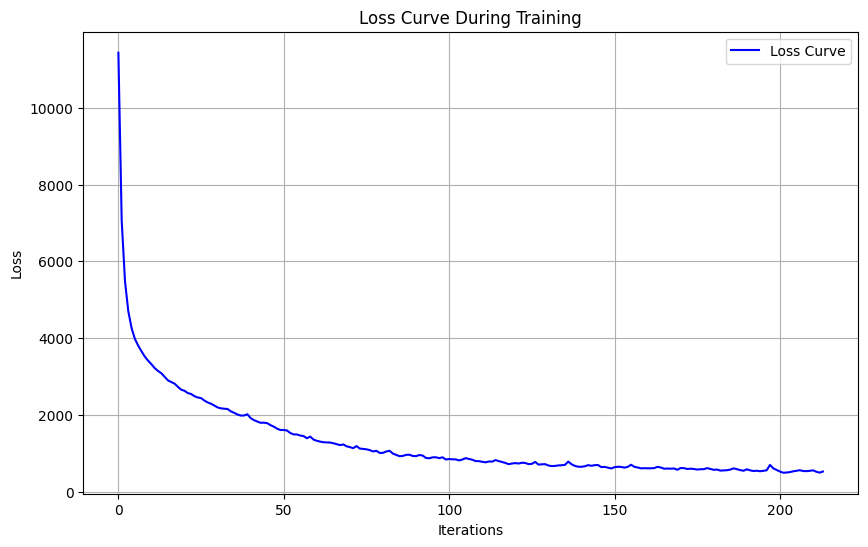

In [44]:
plt.figure(figsize=(10, 6))
plt.plot(best_pipe["Model"].loss_curve_, label='Loss Curve', color='blue')
plt.title('Loss Curve During Training')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

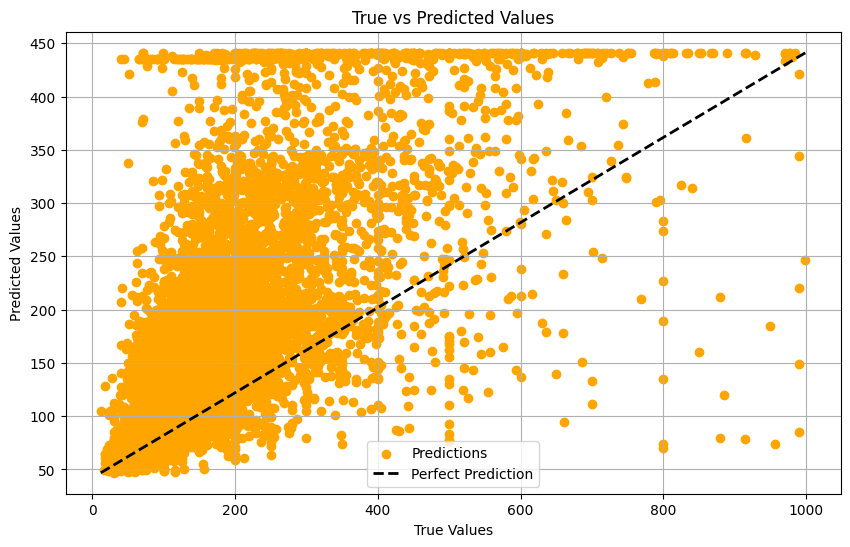

In [45]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, pred, color='orange', label='Predictions')
plt.plot([y_test.min(), y_test.max()], [pred.min(), pred.max()], 'k--', lw=2, label='Perfect Prediction')
plt.title('True vs Predicted Values')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.grid()
plt.show()

In [46]:
import joblib
joblib.dump(best_pipe, 'pickle/MLPR_less1k.pkl', compress=True)

['pickle/MLPR_less1k.pkl']

In [47]:
best_pipe = joblib.load("pickle/MLPR_less1k.pkl")